# Filtering atlas: Agarwal

<div class="alert alert-warning">

**What this notebook does**

In this notebook, the h5ad files of Agarwal et al. will be filtered based on previously calculated quality control metrics such as doublet score, total counts, and percentages mitochondrial and ribosomal counts. Resulting datasets are written to filtered_[atlas_name]_base.h5ad files.
</div>  



### Loading libraries
Using sc2_seurat environment

In [1]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/bin/python
3.9.9 | packaged by conda-forge | (main, Dec 20 2021, 02:40:17) 
[GCC 9.4.0]
sys.version_info(major=3, minor=9, micro=9, releaselevel='final', serial=0)


In [2]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))#embed HTML within IPython notebook and make containers 90% of screen
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import os
import matplotlib.pyplot as plt

%matplotlib inline
sc.settings.verbosity = 0             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, facecolor='white') #figure resolution and background color

# This is used
# os.path.join('data/'+object_names[i][6:10]+'_preprocessed.h5ad')
#sc.logging.print_versions()

## Load data
The filtered .h5ad  files from preprocessing section.

In [3]:
path='/home/hers_basak/jjiang/jack/outputs/deliverables/1_preprocessing/data/preprocessed_'
GSM4157068=f'{path}agarwal_GSM4157068.h5ad'
GSM4157069=f'{path}agarwal_GSM4157069.h5ad'
GSM4157070=f'{path}agarwal_GSM4157070.h5ad'
GSM4157072=f'{path}agarwal_GSM4157072.h5ad'
GSM4157074=f'{path}agarwal_GSM4157074.h5ad'
GSM4157076=f'{path}agarwal_GSM4157076.h5ad'
GSM4157078=f'{path}agarwal_GSM4157078.h5ad'


In [4]:
!ls /home/hers_basak/jjiang/jack/outputs/deliverables/2_filtering/data/

filtered_altena_base_g004.h5ad	filtered_smajic_base_SRR12621867.h5ad
filtered_altena_base_g005.h5ad	filtered_smajic_base_SRR12621868.h5ad
filtered_altena_base_g011.h5ad	filtered_smajic_base_SRR12621869.h5ad
filtered_altena_base_g012.h5ad	filtered_smajic_base_SRR12621870.h5ad
filtered_altena_base_g013.h5ad	filtered_smajic_base_SRR12621871.h5ad
filtered_altena_base_g014.h5ad	filtered_smajic_base_SRR12621872.h5ad
filtered_altena_base_g015.h5ad	filtered_smajic_doublets_SRR12621867.h5ad
filtered_altena_base_g016.h5ad	filtered_smajic_doublets_SRR12621868.h5ad
filtered_altena_base_g017.h5ad	filtered_smajic_doublets_SRR12621869.h5ad
filtered_altena_base_g018.h5ad	filtered_smajic_doublets_SRR12621870.h5ad
filtered_altena_base_g019.h5ad	filtered_smajic_doublets_SRR12621871.h5ad
filtered_altena_base_g020.h5ad	filtered_smajic_doublets_SRR12621872.h5ad


In [5]:
#set data path
os.chdir('/home/hers_basak/jjiang/jack/outputs/deliverables/2_filtering')

In [6]:
os.getcwd()

'/hpc/hers_basak/rnaseq_data/Basaklab/jjiang/outputs/deliverables/2_filtering'

In [7]:
files = [GSM4157068,GSM4157069,GSM4157070,GSM4157072,GSM4157074,GSM4157076,GSM4157078]

In [9]:
names = [name.split('agarwal_')[1].split('.h5ad')[0] for name in files ]
print(names)

['GSM4157068', 'GSM4157069', 'GSM4157070', 'GSM4157072', 'GSM4157074', 'GSM4157076', 'GSM4157078']


In [10]:
object_names_preprocessed =list()
numberobj = len(files)

for i in range(numberobj):
    object_names_preprocessed.append("adata"+"_"+names[i]+"_"+"preprocessed")
    locals()[object_names_preprocessed[i]] = sc.read(files[i]) 
    print(object_names_preprocessed[i],' is loaded')

adata_GSM4157068_preprocessed  is loaded
adata_GSM4157069_preprocessed  is loaded
adata_GSM4157070_preprocessed  is loaded
adata_GSM4157072_preprocessed  is loaded
adata_GSM4157074_preprocessed  is loaded
adata_GSM4157076_preprocessed  is loaded
adata_GSM4157078_preprocessed  is loaded


In [46]:
for i in range(numberobj):
    print(locals()[object_names_preprocessed[i]].obs)

                        species gender  age           instrument technology  \
CTGTGCTTCAGAAATG-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
GCTCCTACAGATCCAT-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
TCAGCAATCGGTCCGA-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
TGACTAGTCACAGGCC-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
TACGGATTCTGTACGA-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
...                         ...    ...  ...                  ...        ...   
TCTTCGGAGTGCGTGA-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
CTAACTTAGATGAGAG-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
CACACCTTCCCTTGTG-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
TCACGAAAGTCCTCCT-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   
AGTGAGGAGTTGAGAT-1  Homo sapien   male   59  Illumina HiSeq 4000     10x_v3   

                      atlas      sample batch_1  do

## Preprocess - Doublets

<div class="alert alert-warning">

**Important note about doublet filtering**
    
Some samples have non 'bimodal' distribution expression, which results in the automatic doublet score threshold to be very high and suspicious doublets to not be filtered out. \
    **TO DO** \
I decided to manually set the threshold to 0.20 to see if this captures the suspicious cells. Furthermore to see in UMAP if these cells cluster together or are more dispersed.
    

</div>  

### Check gene counts of high doublet scores
Note the graph shows counts excluding mt ones. check cells with NaN doublet scores if they can be removed. GSM4157076 has 1 NaN droplet with only 1 count, this can be removed.

In [31]:
adata_GSM4157076_preprocessed[adata_GSM4157076_preprocessed.obs['doublet_score'].isnull()]

,species,gender,age,instrument,technology,atlas,sample,batch_1,doublet_score,predicted_doublet,...,total_counts,log1p_total_counts,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,total_counts_ribo,log1p_total_counts_ribo,pct_counts_ribo,n_genes,total_counts_mito
CAAGGCCCACGAAAGC-1,Homo sapien,male,70,Illumina HiSeq 4000,10x_v3,agarwal,GSM4157076,day_2,NaN,nan,...,1,0.693147,0,0.0,0.0,0,0.0,0.0,1,1


In [67]:
for i in range(numberobj):
    print(locals()[object_names_preprocessed[i]].obs['total_counts'])


CTGTGCTTCAGAAATG-1    86326
GCTCCTACAGATCCAT-1    81794
TCAGCAATCGGTCCGA-1    78684
TGACTAGTCACAGGCC-1    73052
TACGGATTCTGTACGA-1    59683
                      ...  
TCTTCGGAGTGCGTGA-1      177
CTAACTTAGATGAGAG-1      174
CACACCTTCCCTTGTG-1      165
TCACGAAAGTCCTCCT-1      165
AGTGAGGAGTTGAGAT-1      142
Name: total_counts, Length: 2268, dtype: uint64
CCTTCCCTCACCCTCA-1    48000
GATCGCGTCAGCACAT-1    39431
GCTGCGACAATAACGA-1    33095
GGCTGGTTCCACGTGG-1    32447
GCAGCCATCCTACAGA-1    32110
                      ...  
AAATGCCAGACGCAAC-1       73
AACCATGGTTTGACAC-1       74
TTGACTTAGAGCCCAA-1       60
CGATTGATCTGCGTAA-1       45
CTGATCCAGAAGGTTT-1       14
Name: total_counts, Length: 2462, dtype: uint64
CTCATTACAAGCCCAC-1    69670
CGATCGGCATAAGACA-1    51589
ATCTACTAGCTAAACA-1    44404
CAGTCCTAGACAAGCC-1    42445
AGGCCACCATGACGGA-1    36792
                      ...  
AGCTTGAGTAGGGACT-1      184
CTCGGAGGTCAGAGGT-1      139
CTGAAGTCATCGTCGG-1      126
GTGCATAAGTTTAGGA-1      127
TGCGTGGA

compare total counts between doublet score >0.2 and <0.2.

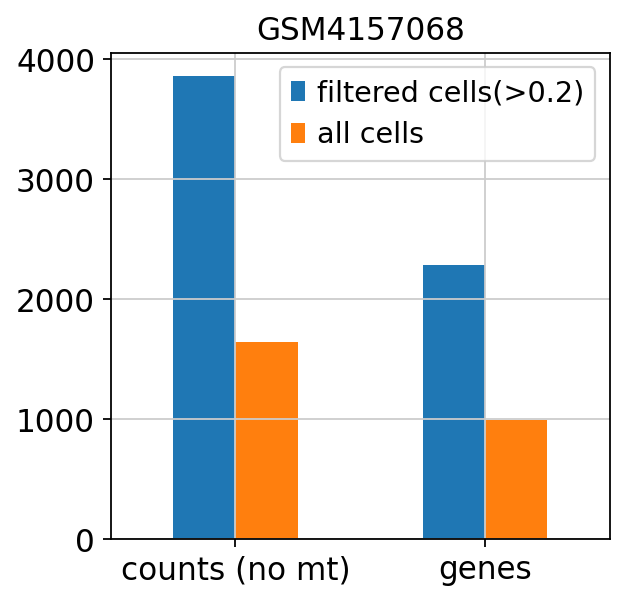

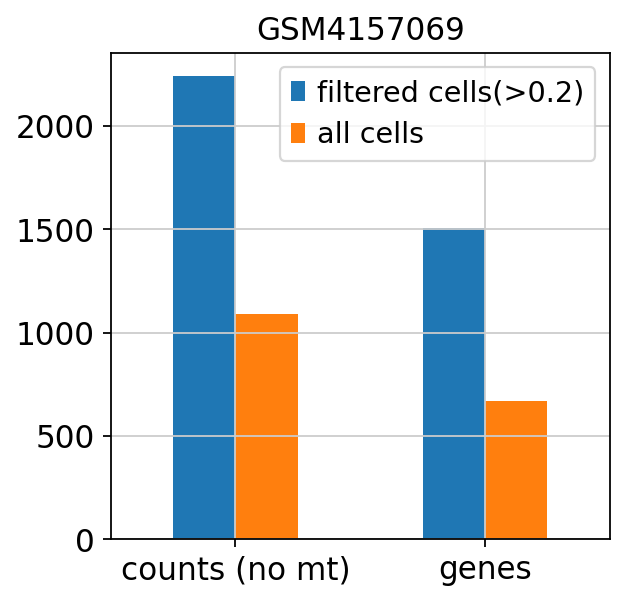

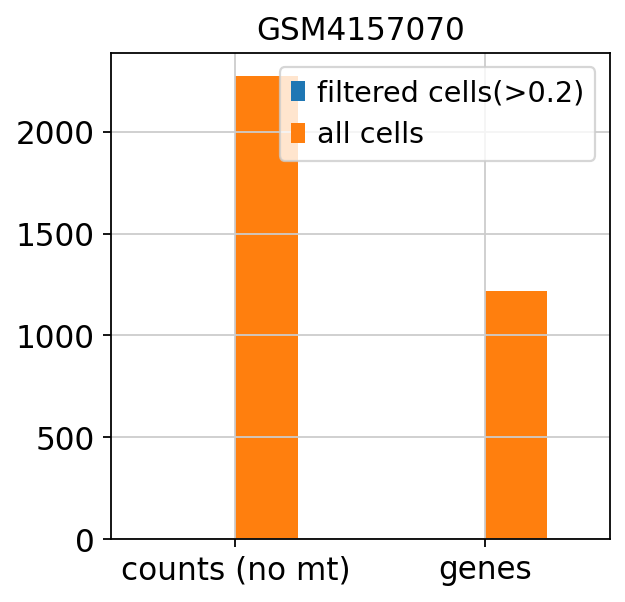

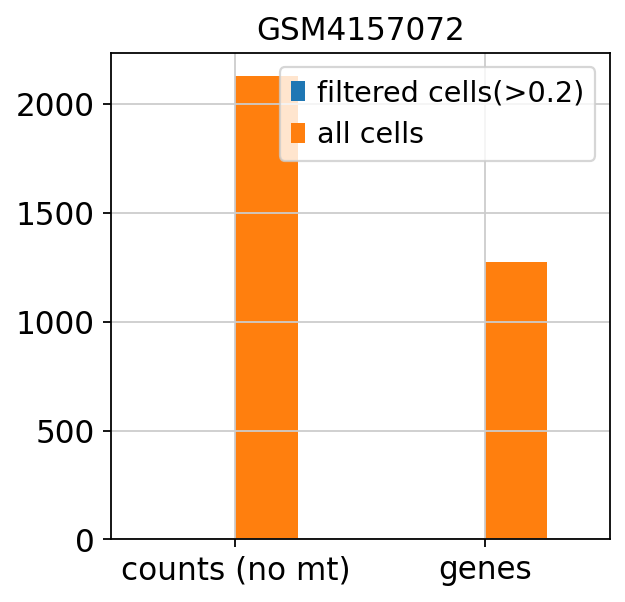

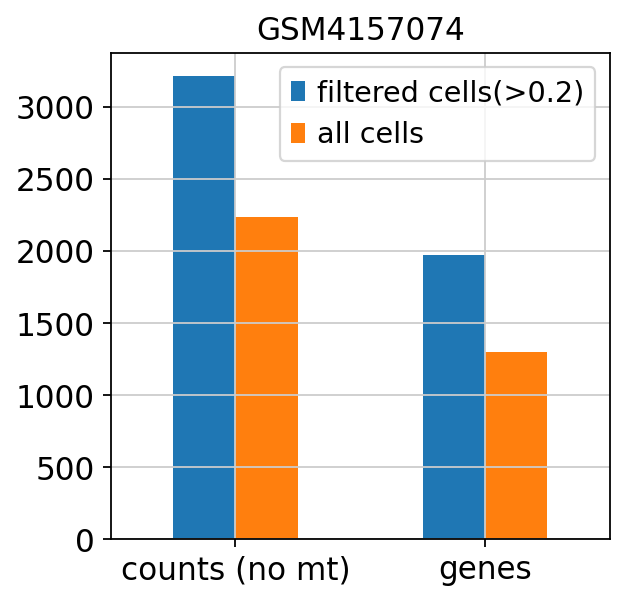

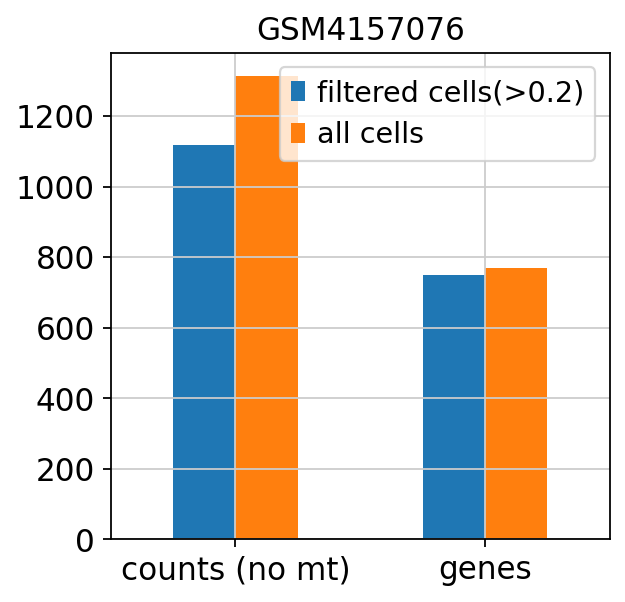

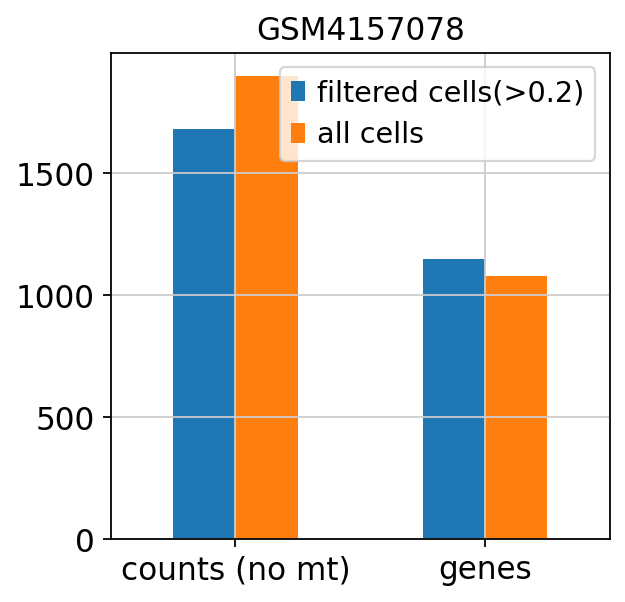

In [69]:
thr =[0.2 for i in range(numberobj)]
for i in range(numberobj):
    mean_counts_high = np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['doublet_score'] > thr[i]]['total_counts'])
    mean_genes_high = (np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['doublet_score'] >thr[i]]['n_genes']))
    mean_counts = (np.mean(locals()[object_names_preprocessed[i]].obs['total_counts']))
    mean_genes = (np.mean(locals()[object_names_preprocessed[i]].obs['n_genes']))
    
    
    filtered_cells = [mean_counts_high,mean_genes_high]
    all_cells = [mean_counts,mean_genes]
    index = ['counts (no mt)', 'genes']
    
    
    df = pd.DataFrame({f'filtered cells(>{thr[i]})': filtered_cells, 'all cells': all_cells}, index=index)
    
    ax = df.plot.bar(rot=0,title=names[i])
    
    #print(locals()[object_names[i]].obs[locals()[object_names[i]].obs['doublet_score'] >0.25][['doublet_score','total_counts']])


Compare automatically set thresholds predicted doublets vs the non doublets total counts

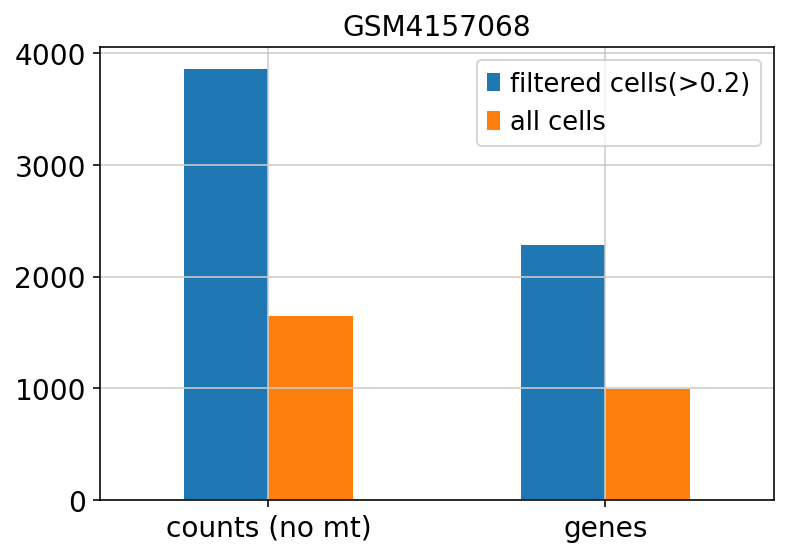

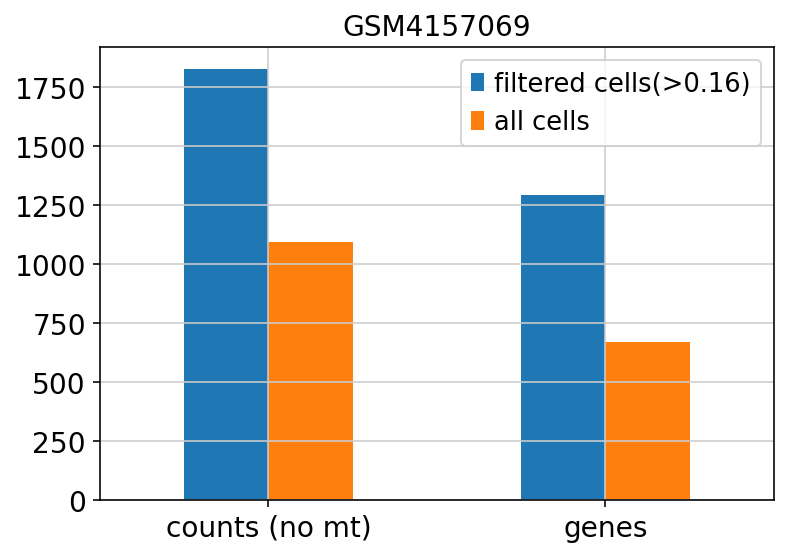

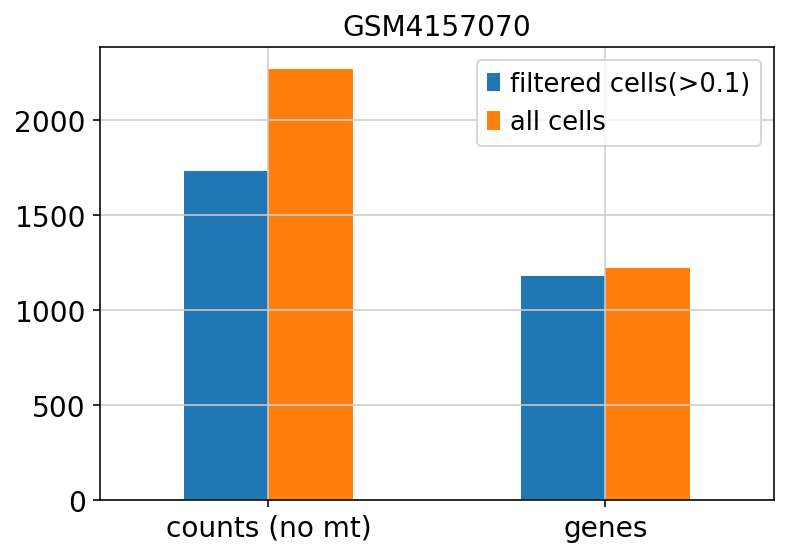

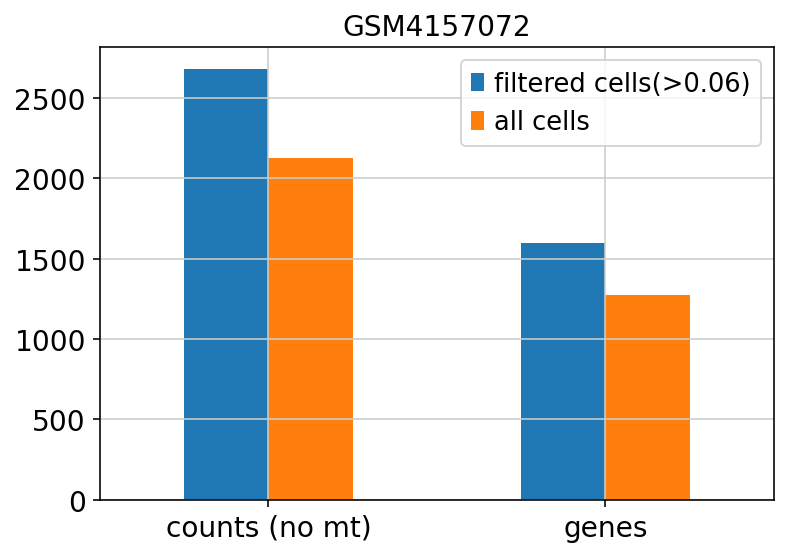

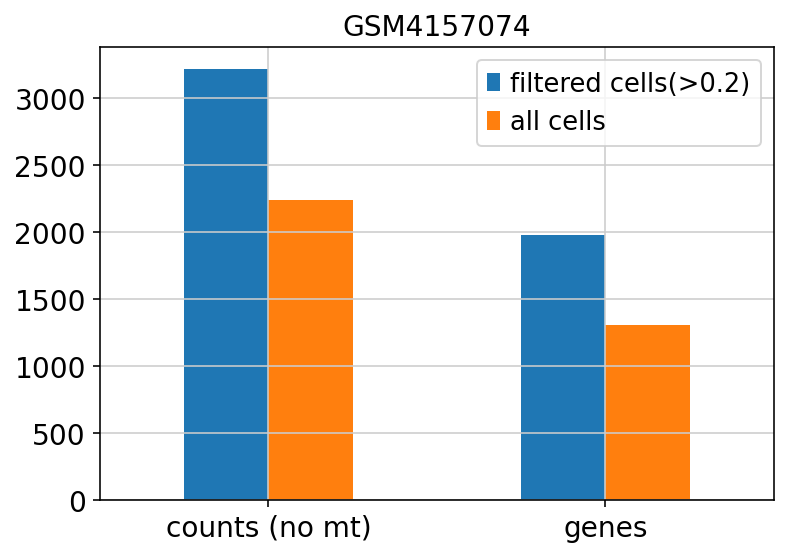

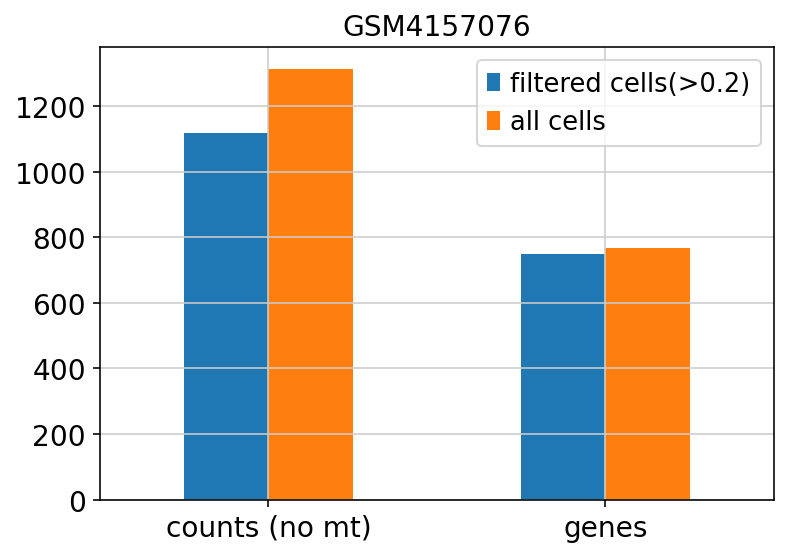

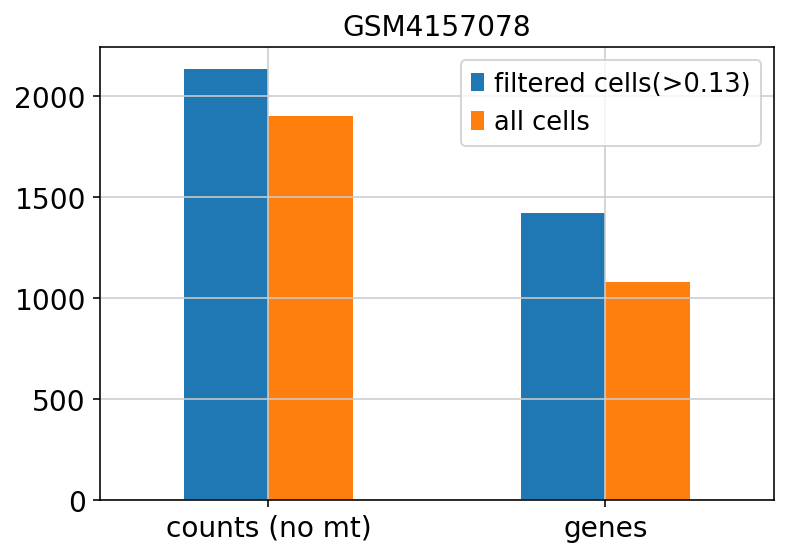

In [73]:
thr =[0.20,0.16,0.1,0.06,0.20,0.20,0.13]
for i in range(numberobj):
    mean_counts_high = np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'True']['total_counts'])
    mean_genes_high =np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'True']['n_genes'])
    mean_counts = np.mean(locals()[object_names_preprocessed[i]].obs['total_counts'])
    mean_genes = np.mean(locals()[object_names_preprocessed[i]].obs['n_genes'])
    
    
    filtered_cells = [mean_counts_high,mean_genes_high]
    all_cells = [mean_counts,mean_genes]
    index = ['counts (no mt)', 'genes']
    
    df = pd.DataFrame({f'filtered cells(>{thr[i]})': filtered_cells, 'all cells': all_cells}, index=index)
    ax = df.plot.bar(rot=0,title=names[i])
    
    #print(locals()[object_names[i]].obs[locals()[object_names[i]].obs['doublet_score'] >0.25][['doublet_score','total_counts']])


GSM4157070 and GSM4157076 predicted doublets have very low count compared to the rest of the droplets. GSM4157072 and GSM4157078 are very close as well.

In [74]:
np.random.seed(41)
%matplotlib inline

Normalize to compare suspicious cells

In [75]:

for i in range(numberobj):
    locals()['test_'+names[i]]=locals()[object_names_preprocessed[i]].copy()
    
    sc.pp.normalize_total(locals()['test_'+names[i]], key_added='total_counts_norm')
    locals()['test_'+names[i]].raw = locals()['test_'+names[i]].copy()
    sc.pp.log1p(locals()['test_'+names[i]])
    print('test_',names[i], ' has been normalized and logarithmized')
    
    sc.tl.pca(locals()['test_'+names[i]], svd_solver='arpack')
    
    

test_ GSM4157068  has been normalized and logarithmized
test_ GSM4157069  has been normalized and logarithmized
test_ GSM4157070  has been normalized and logarithmized
test_ GSM4157072  has been normalized and logarithmized
test_ GSM4157074  has been normalized and logarithmized
test_ GSM4157076  has been normalized and logarithmized
test_ GSM4157078  has been normalized and logarithmized


In [76]:
nn=15
for i in range(numberobj):
    print('test_',names[i], ': done')
    sc.pp.neighbors(locals()['test_'+names[i]], n_neighbors=nn, n_pcs=40)
    sc.tl.umap(locals()['test_'+names[i]])
    
    

test_ GSM4157068 : done
test_ GSM4157069 : done
test_ GSM4157070 : done
test_ GSM4157072 : done
test_ GSM4157074 : done
test_ GSM4157076 : done
test_ GSM4157078 : done


GSM4157068


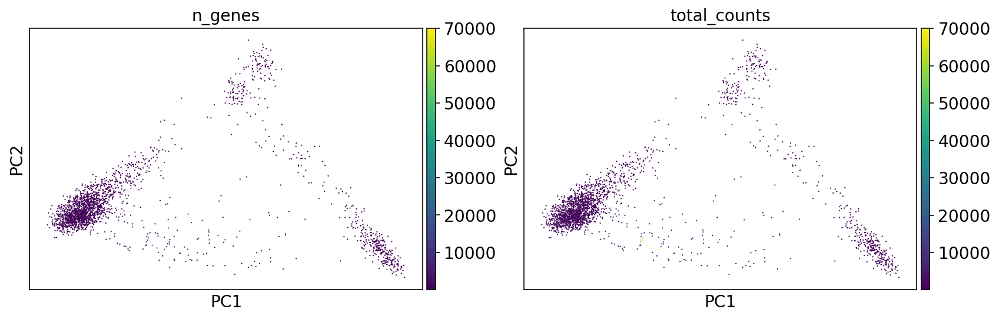

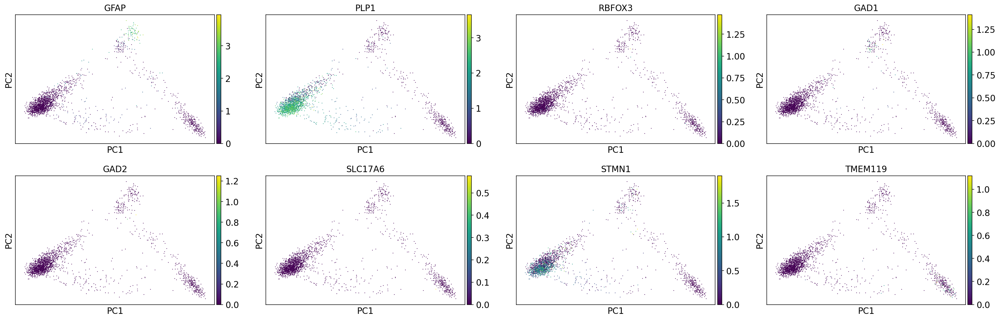

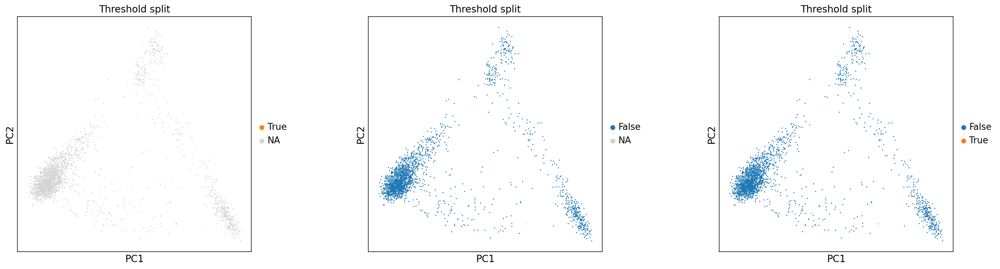

GSM4157069


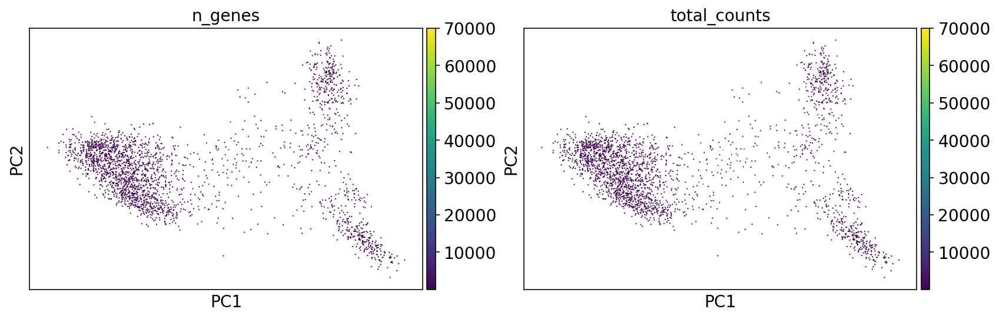

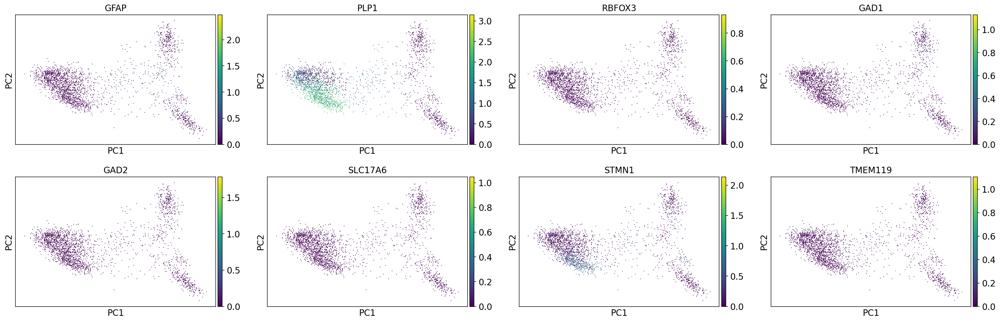

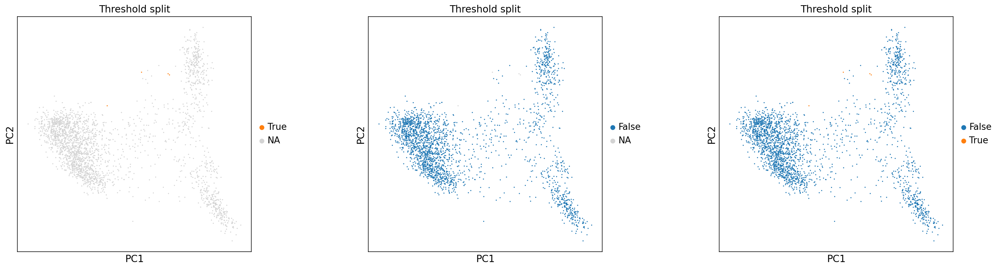

GSM4157070


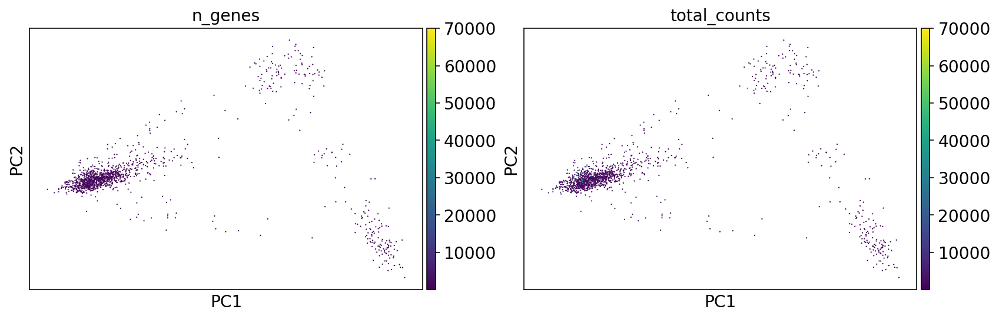

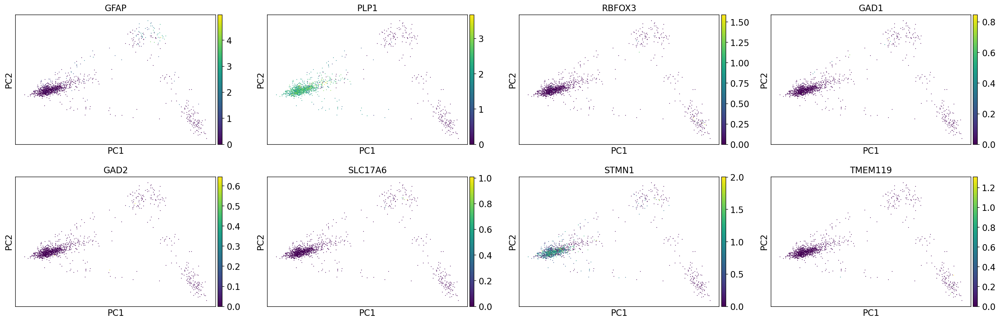

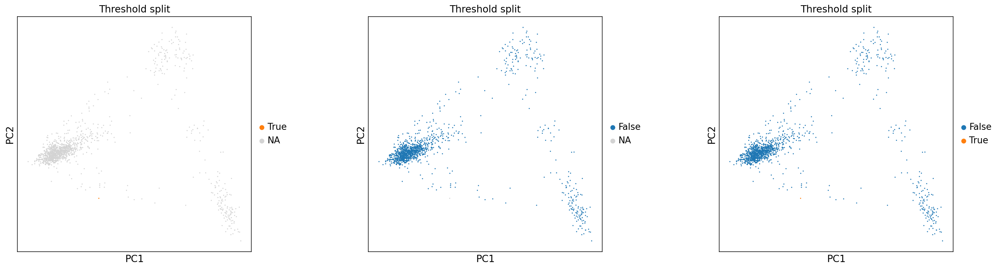

GSM4157072


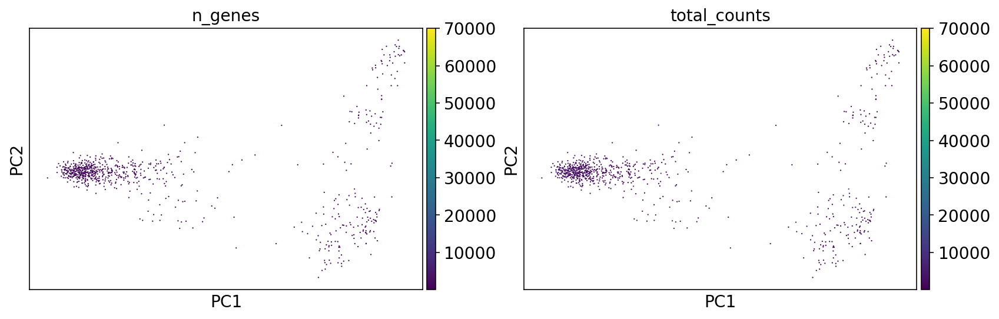

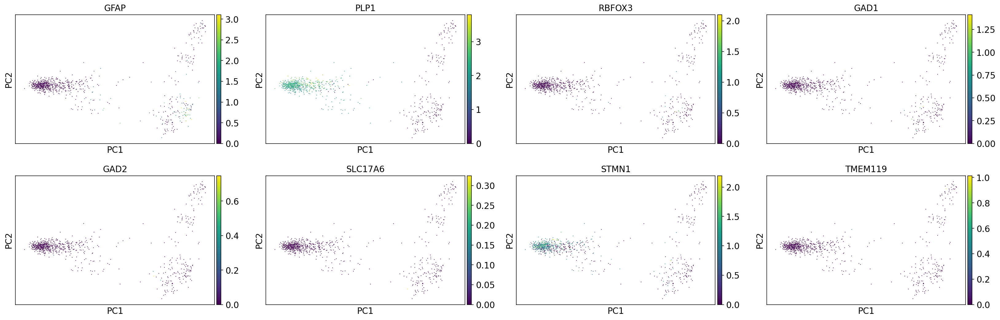

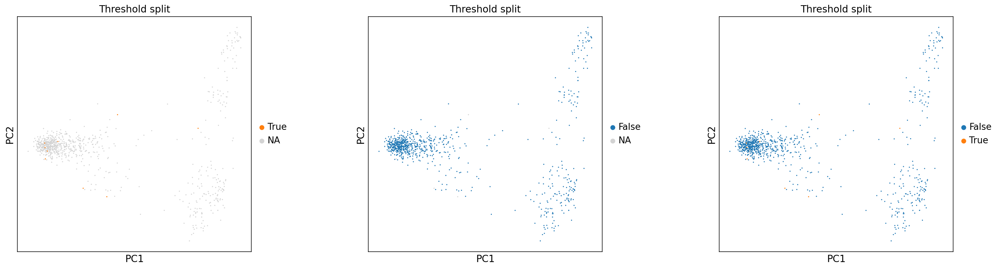

GSM4157074


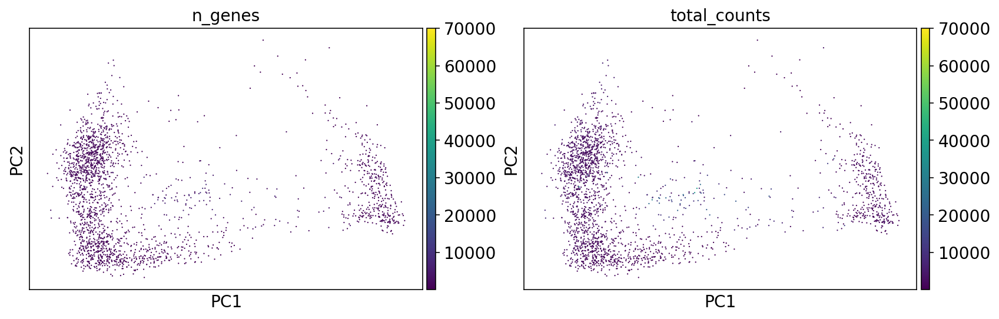

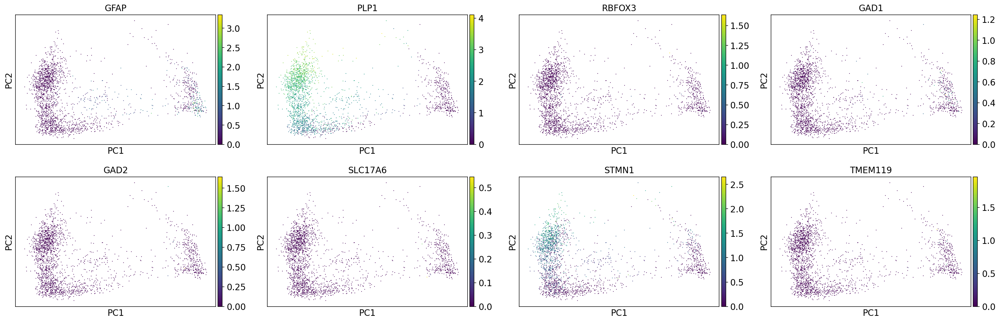

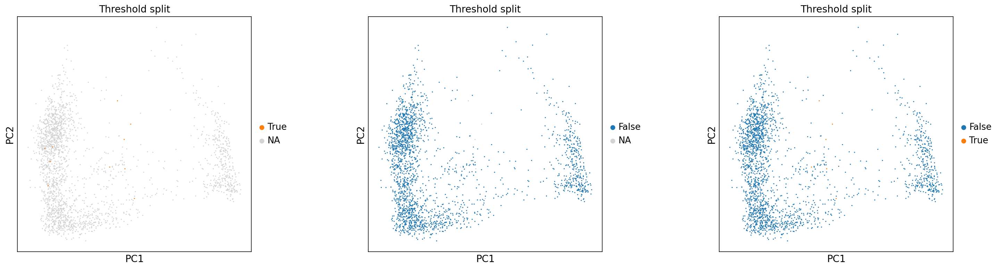

GSM4157076


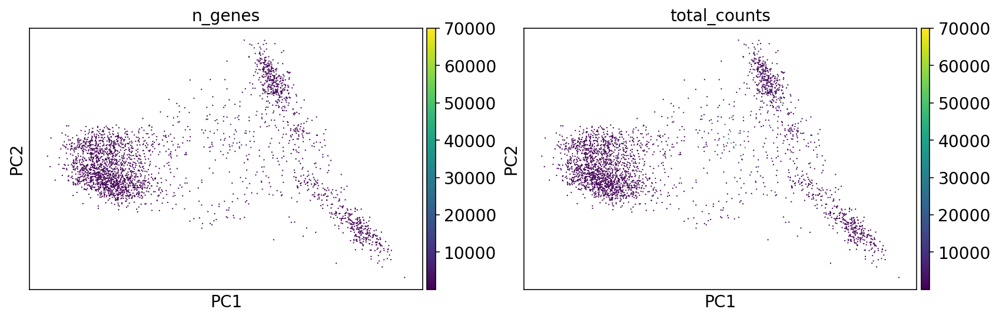

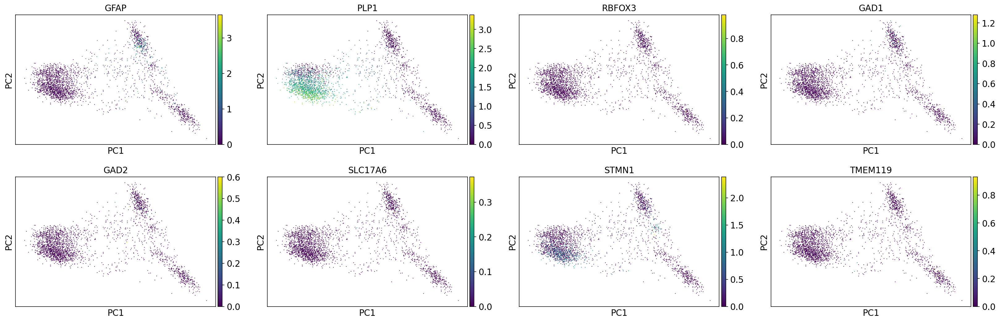

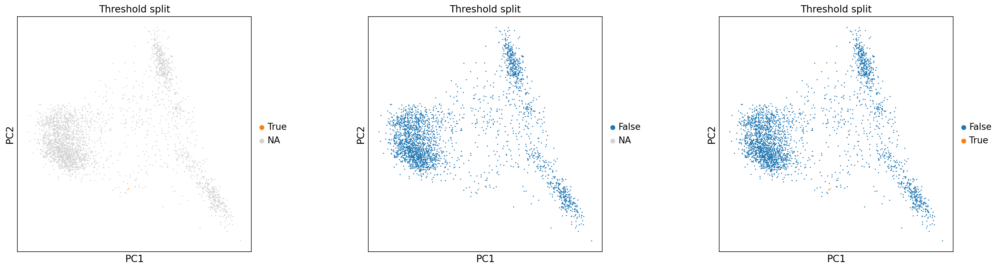

GSM4157078


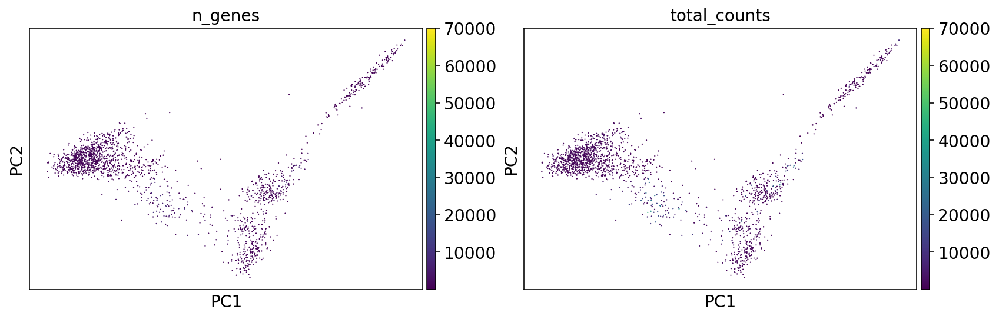

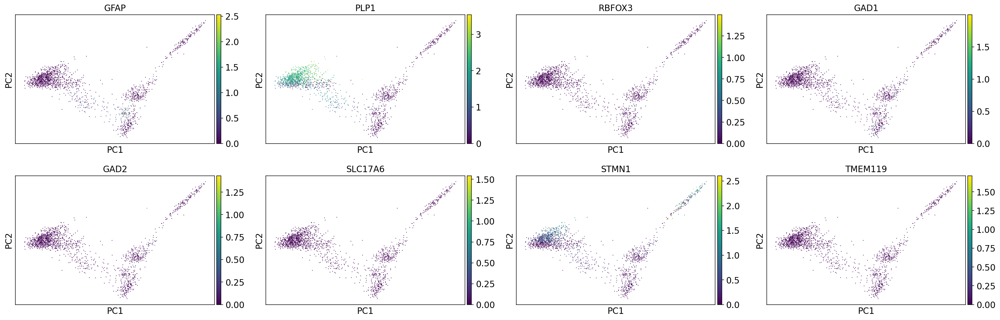

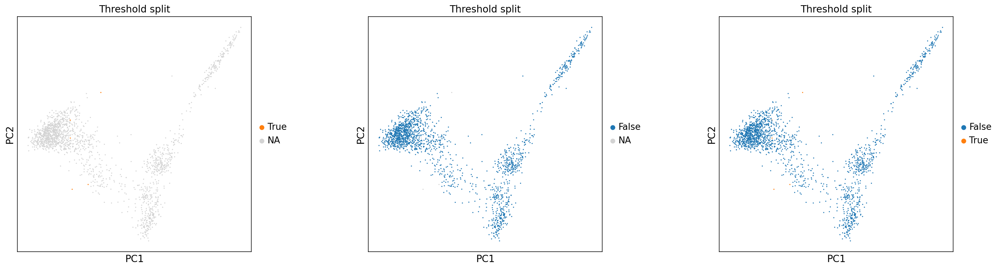

In [77]:
for i in range(numberobj):
    print(names[i])
    
    sc.pl.pca(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=70000)
    sc.pl.pca(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    feature= 'predicted_doublet'
    group1= 'True'
    group2= 'False'
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    plt.show()

GSM4157068


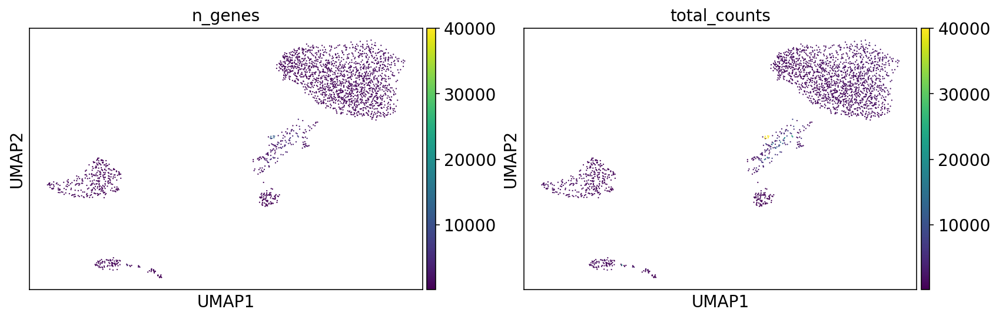

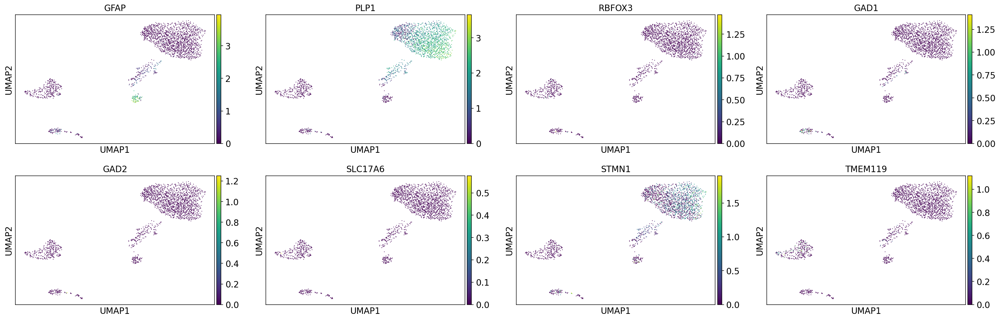

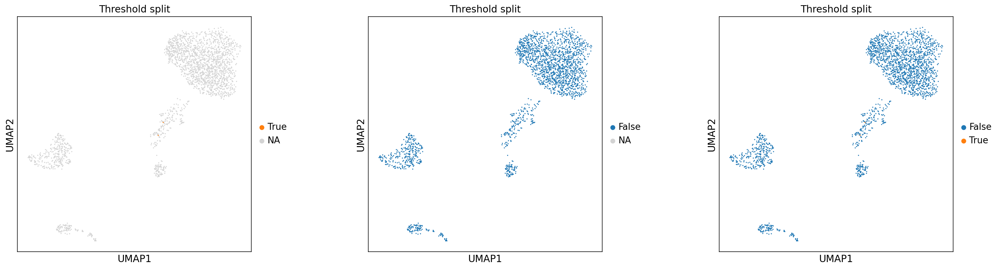

GSM4157069


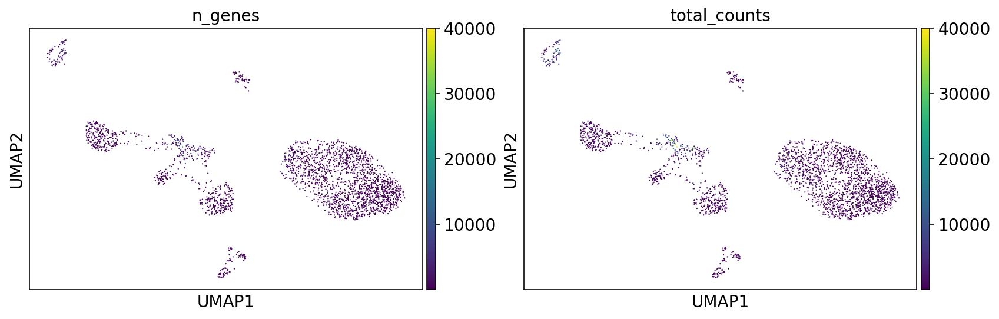

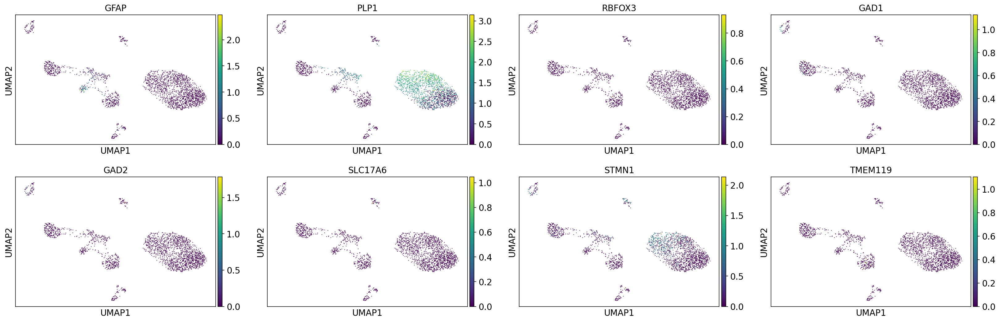

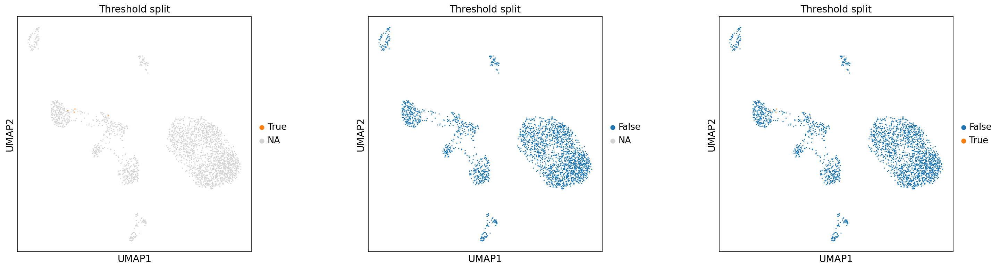

GSM4157070


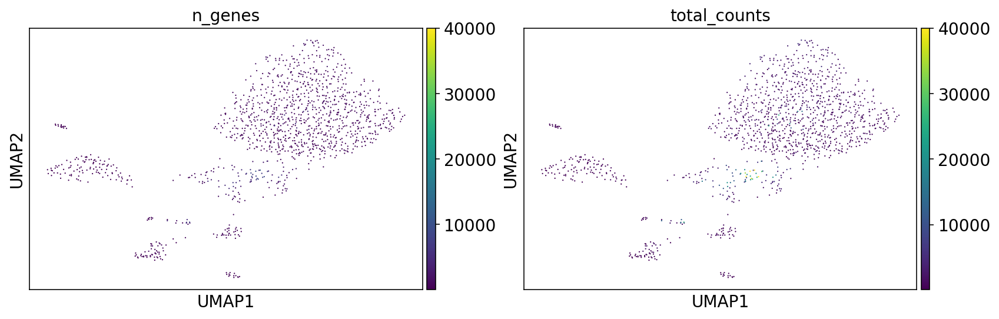

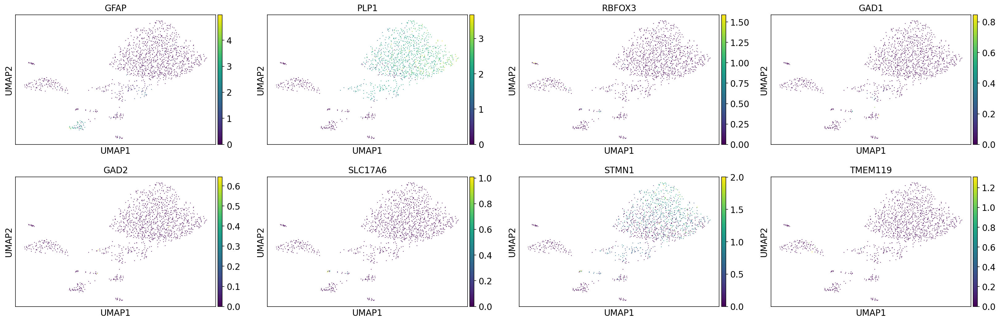

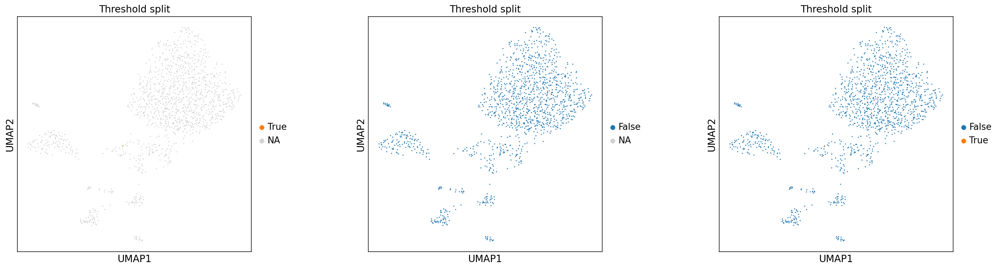

GSM4157072


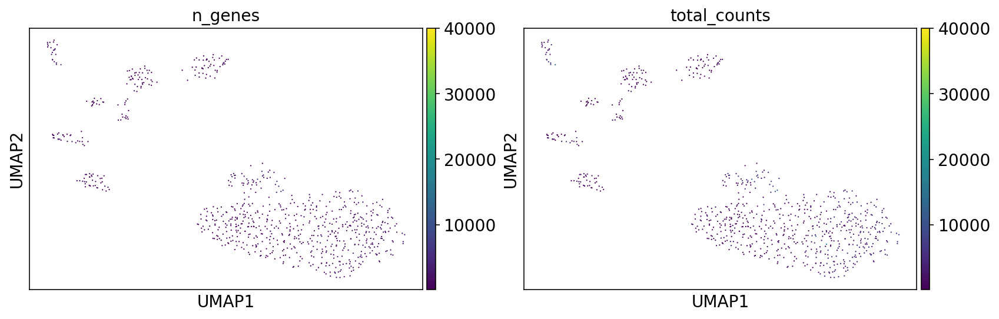

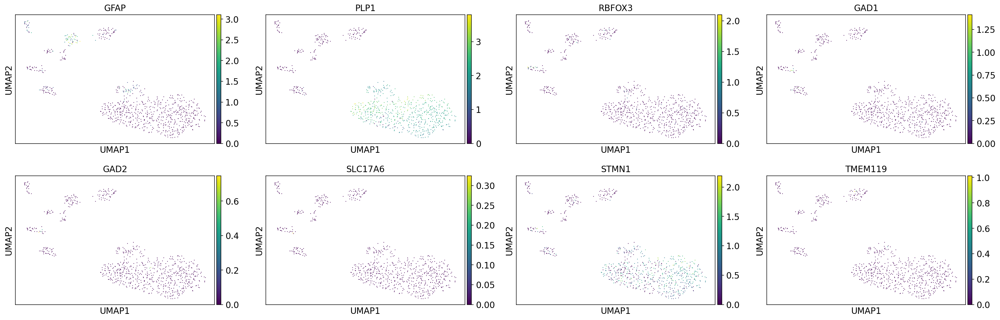

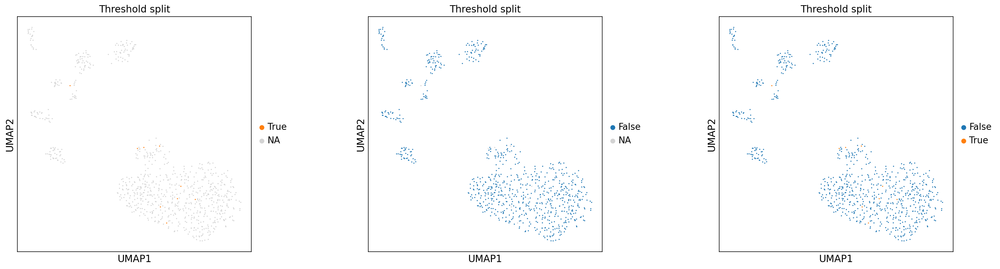

GSM4157074


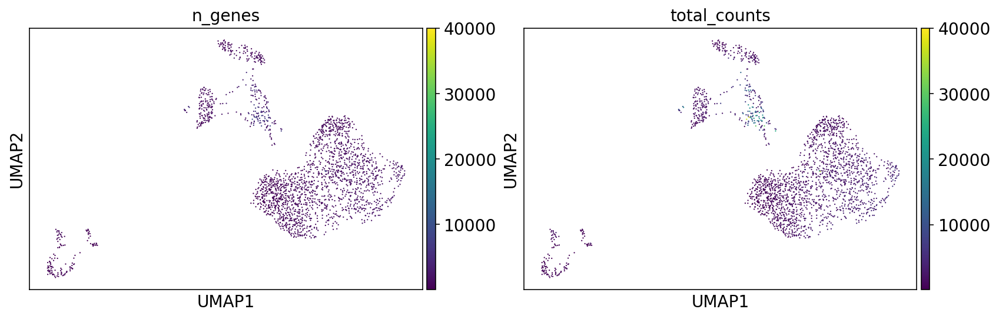

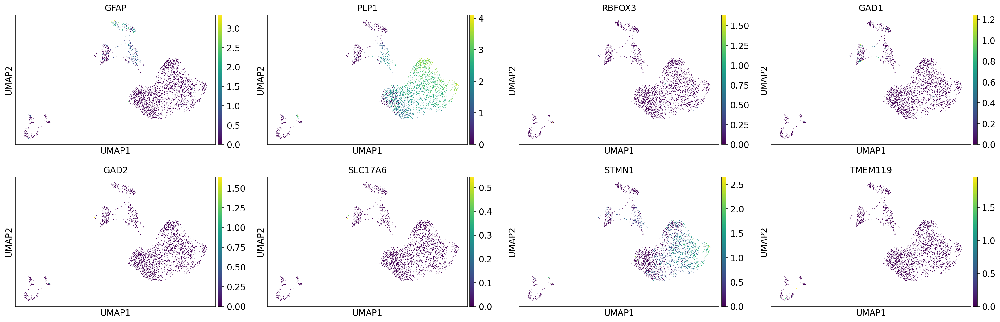

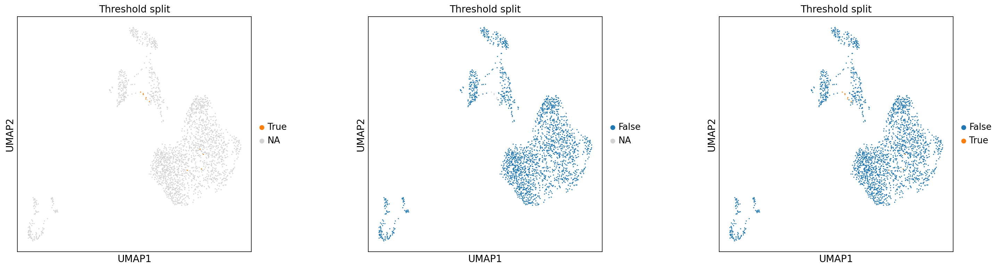

GSM4157076


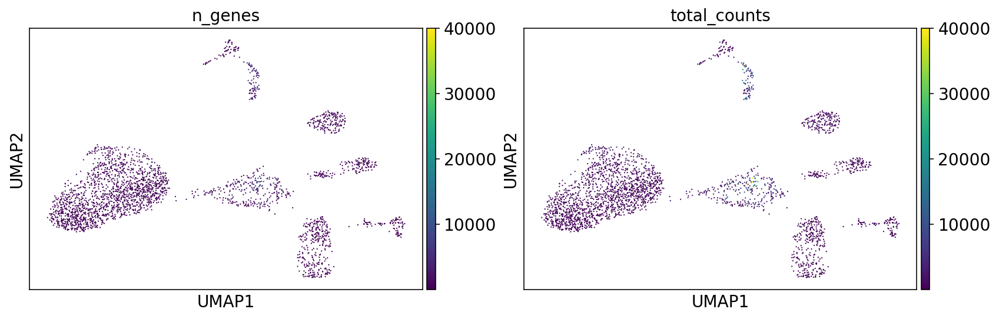

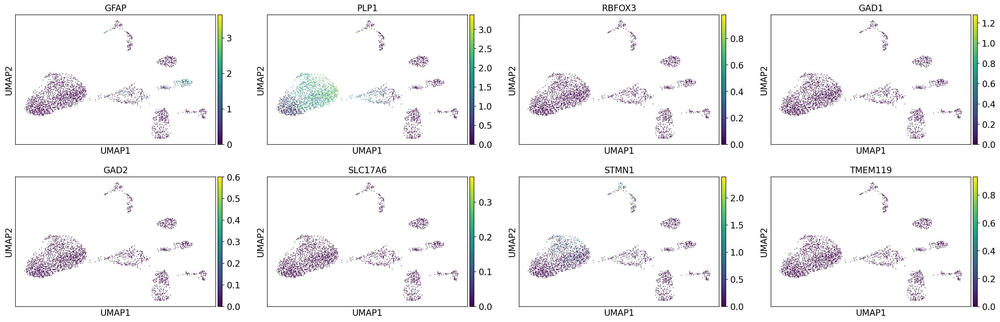

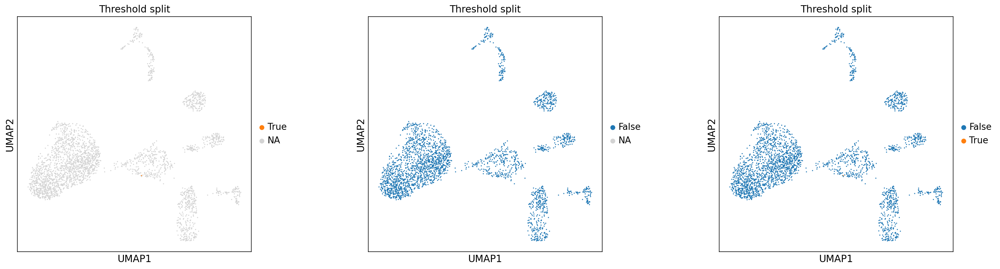

GSM4157078


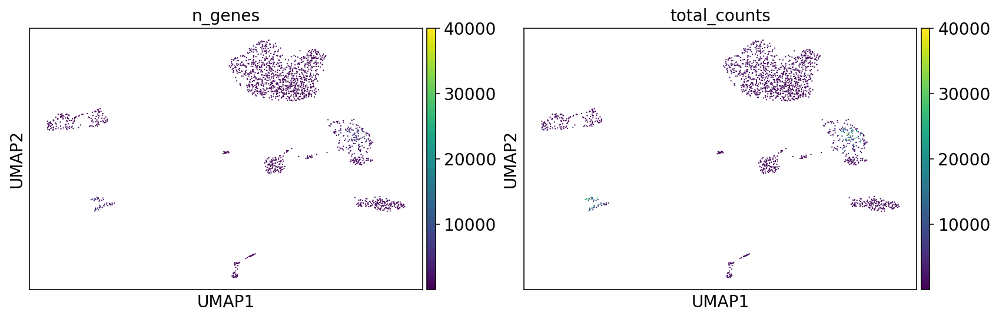

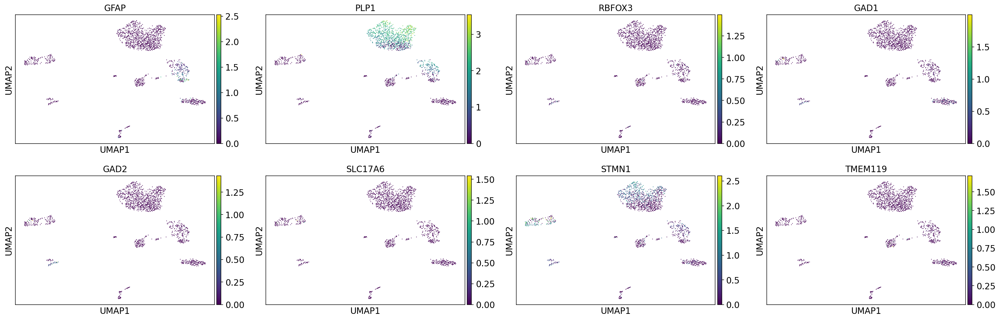

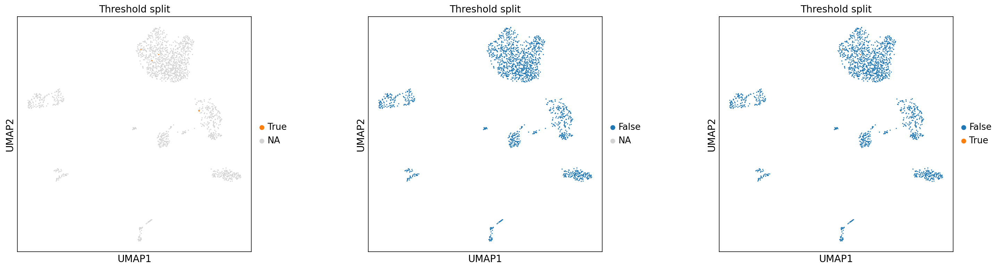

In [78]:

for i in range(numberobj):
    print(names[i])
    
    sc.pl.umap(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=40000)
    sc.pl.umap(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    feature= 'predicted_doublet'
    group1= 'True'
    group2= 'False'
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    plt.show()

GSM4157068
GSM4157069
GSM4157070
GSM4157072
GSM4157074
GSM4157076
GSM4157078


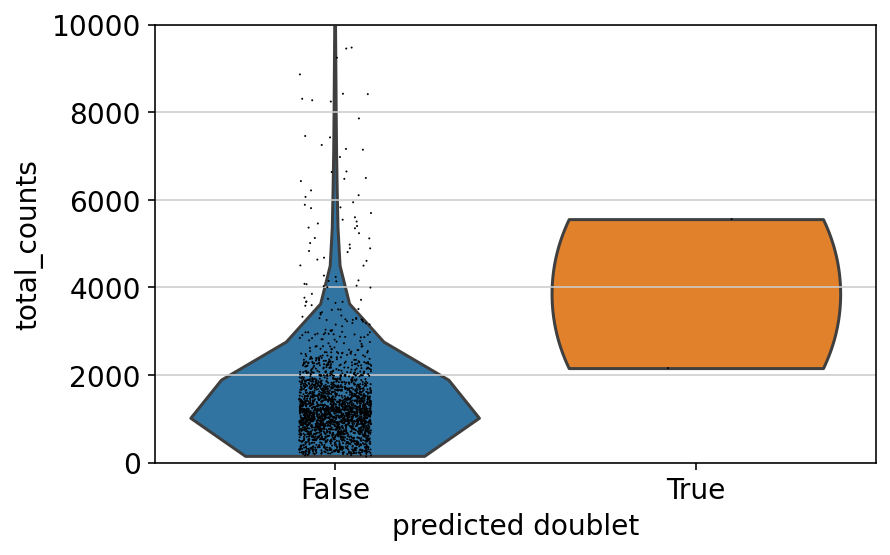

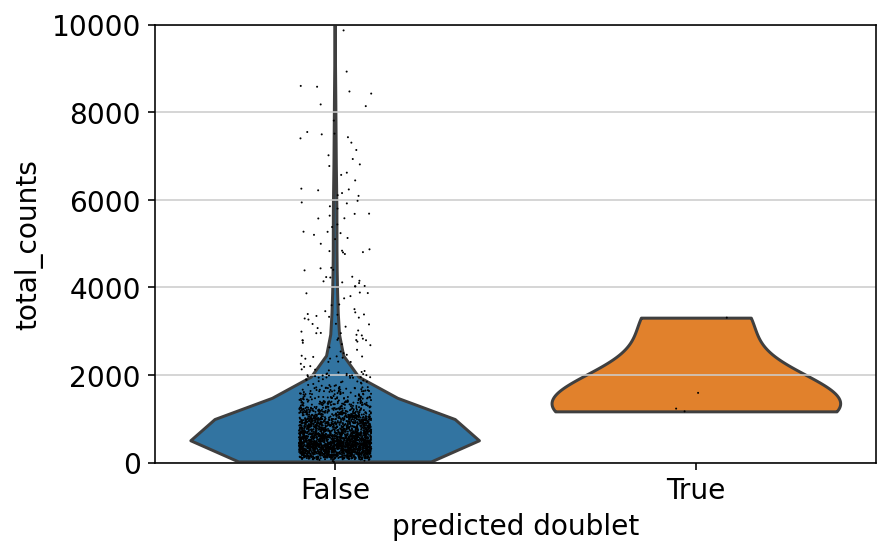

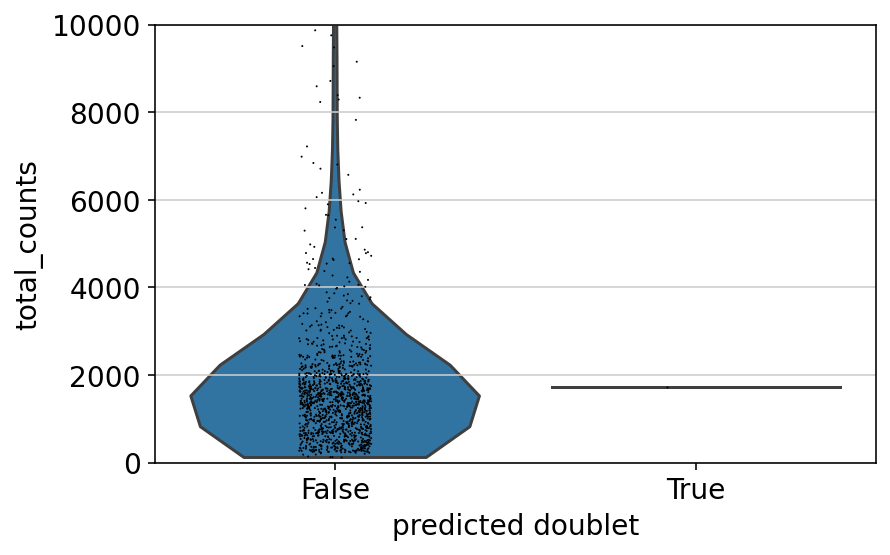

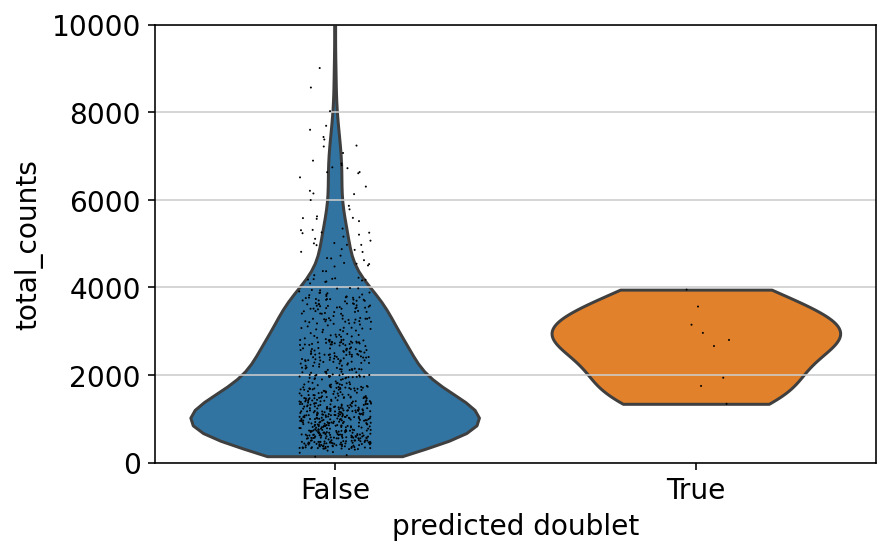

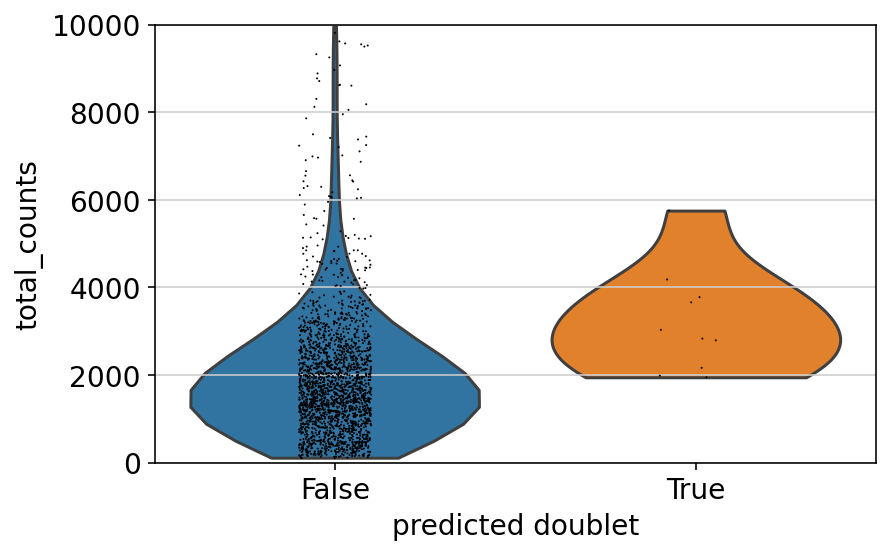

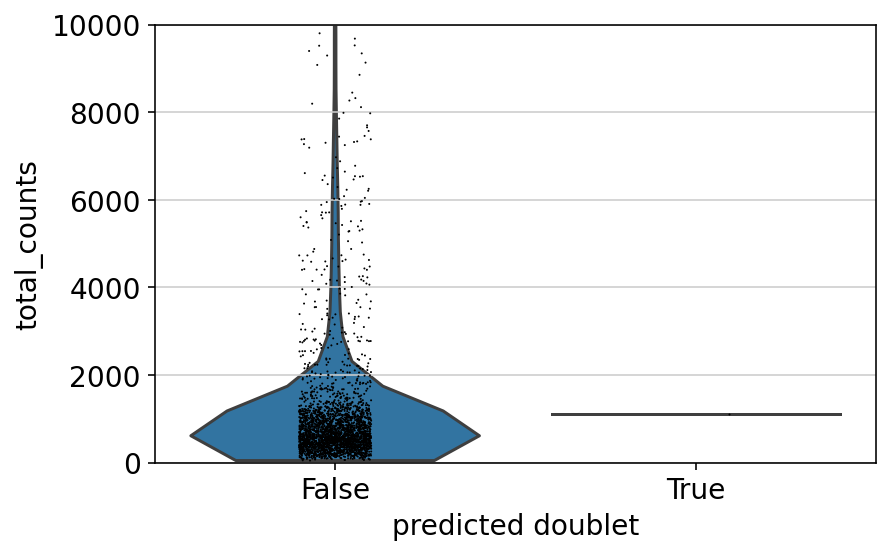

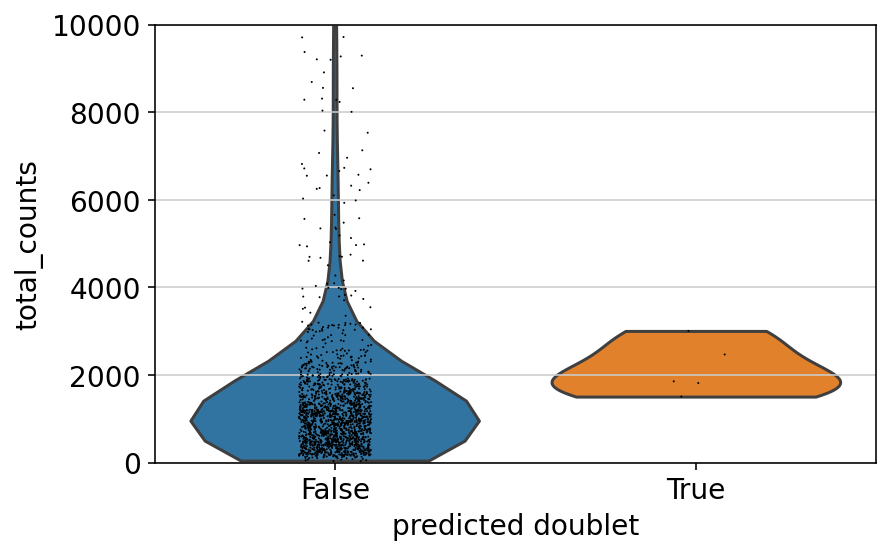

In [81]:
for i in range(numberobj):
    print(names[i])
    ax =sc.pl.violin(locals()['test_'+names[i]], keys='total_counts', groupby='predicted_doublet', show=False)
    ax.set_ylim(bottom=0,top=10000)

<div class="alert alert-warning">
All samples have very low doublets scores, this might explain the high UMI count. The predicted doublets are also on the higher side of distribution. Knowing this we can leave the automatically set threshold

### Filtering - Doublets
Data points between clusters and in the middle of clusters with high count values are more likely to be doublets, but we can't be sure.

In [82]:
#max_doub_score = 0.2 

for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'False']
    print(object_names_preprocessed[i],': filtered!')

adata_GSM4157068_preprocessed : filtered!
adata_GSM4157069_preprocessed : filtered!
adata_GSM4157070_preprocessed : filtered!
adata_GSM4157072_preprocessed : filtered!
adata_GSM4157074_preprocessed : filtered!
adata_GSM4157076_preprocessed : filtered!
adata_GSM4157078_preprocessed : filtered!


Recalculate values, especially total_counts and without ribo/mito pct change, because there is no mito genes anymore

In [83]:
for i in range(numberobj):
    sc.pp.calculate_qc_metrics(locals()[object_names_preprocessed[i]], expr_type='counts', var_type='genes', qc_vars=(), percent_top= (), layer= None, use_raw= False, inplace=True, log1p=True)
    print(object_names_preprocessed[i],': updated!')

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_GSM4157068_preprocessed : updated!
adata_GSM4157069_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_GSM4157070_preprocessed : updated!
adata_GSM4157072_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_GSM4157074_preprocessed : updated!
adata_GSM4157076_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_GSM4157078_preprocessed : updated!


## Preprocess - Mitochondrial and Ribosomal counts

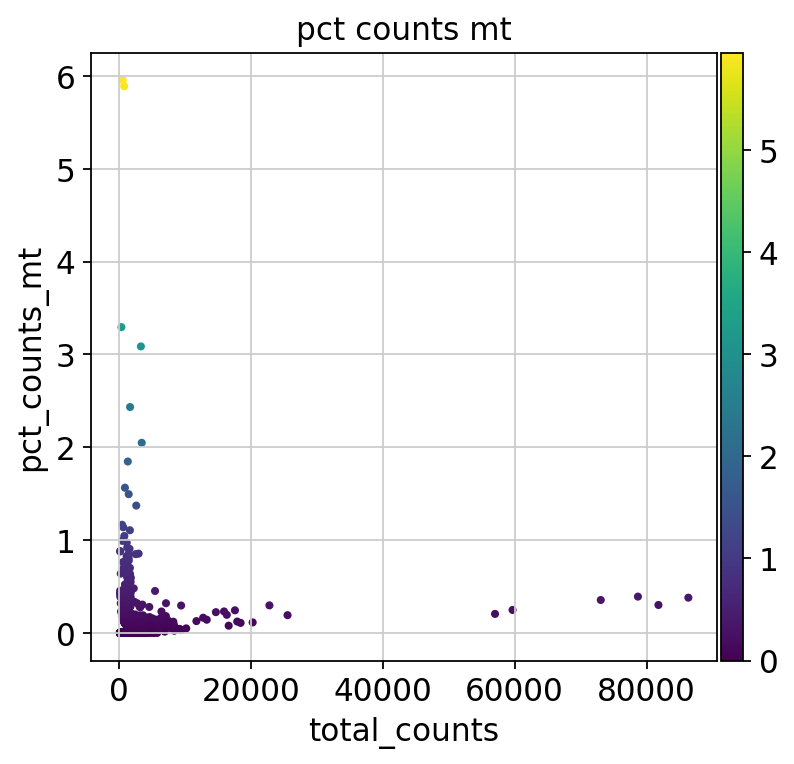

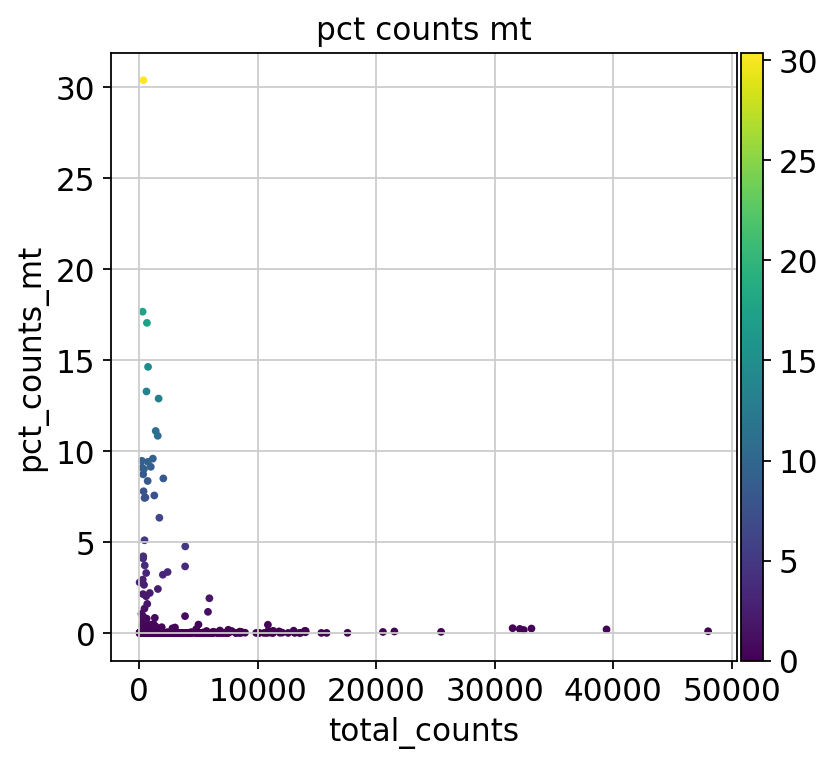

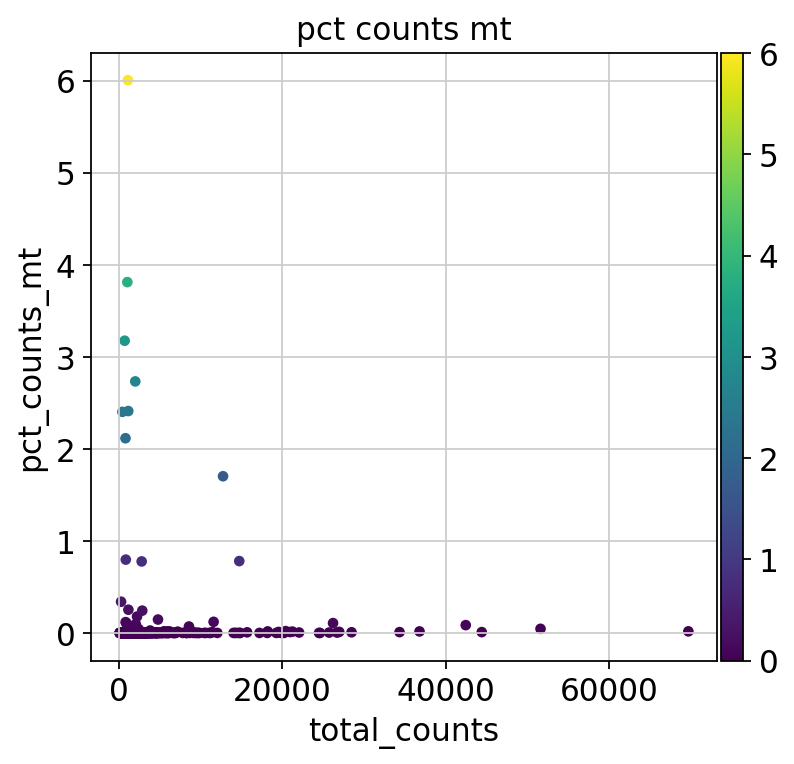

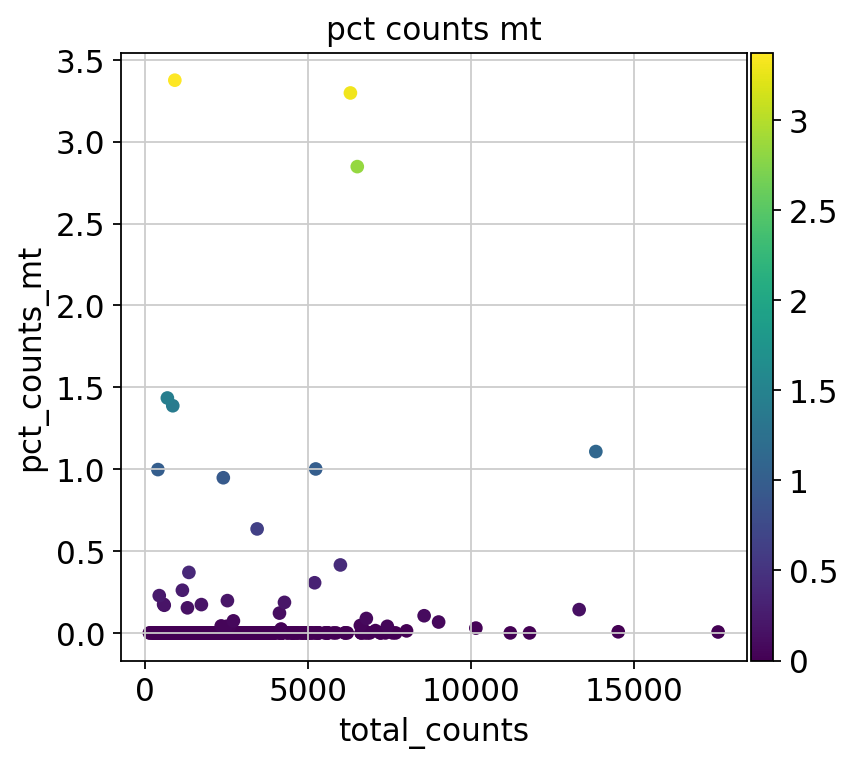

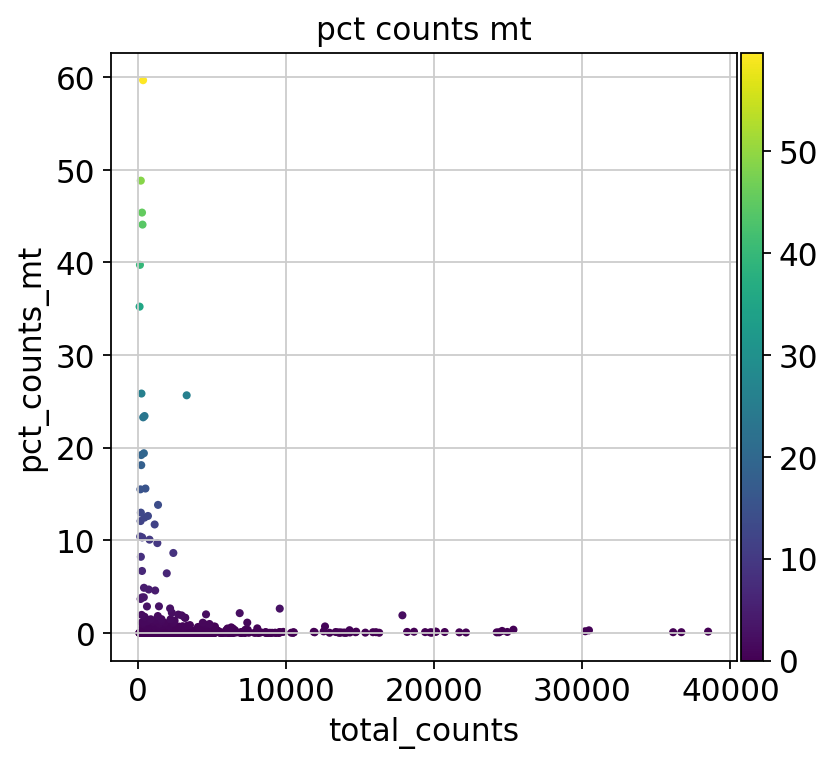

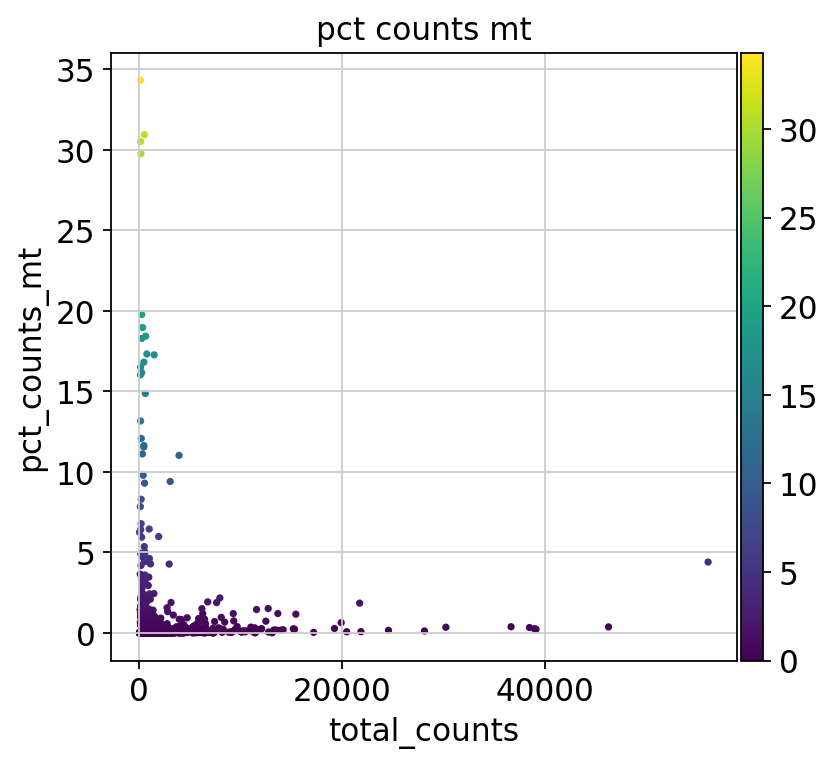

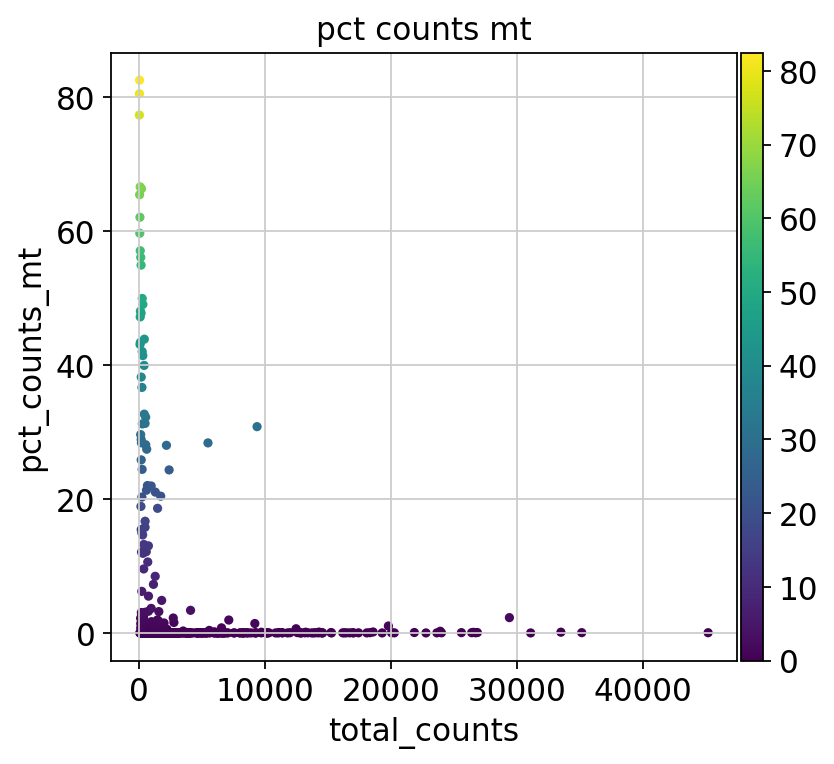

In [84]:
sc.set_figure_params(figsize=[5,5])
for i in range(numberobj):
    sc.pl.scatter(locals()[object_names_preprocessed[i]], x='total_counts', y='pct_counts_mt',color = 'pct_counts_mt',show=False)

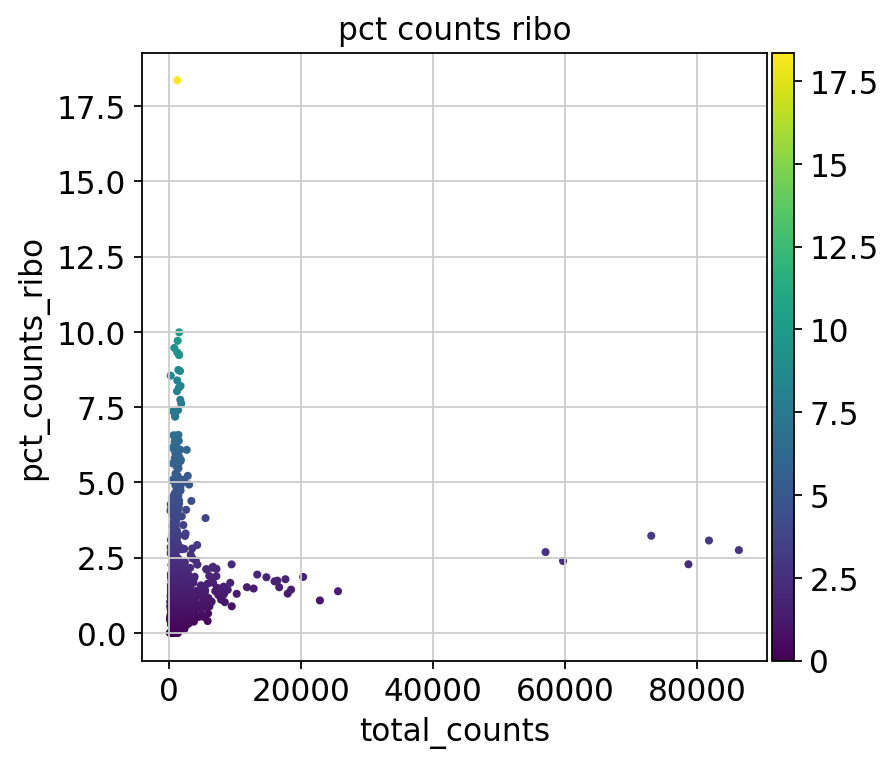

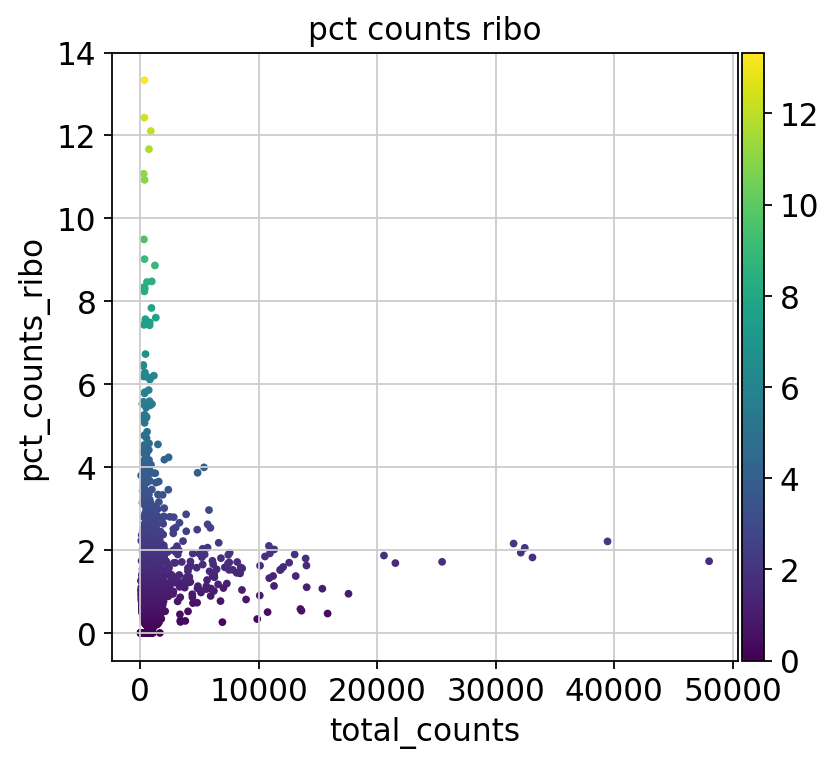

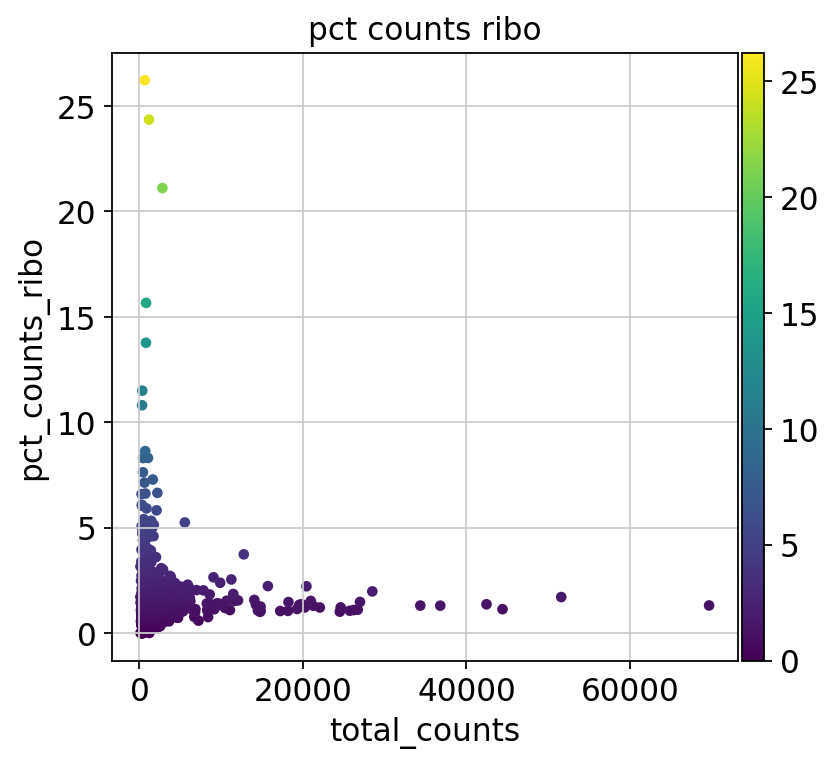

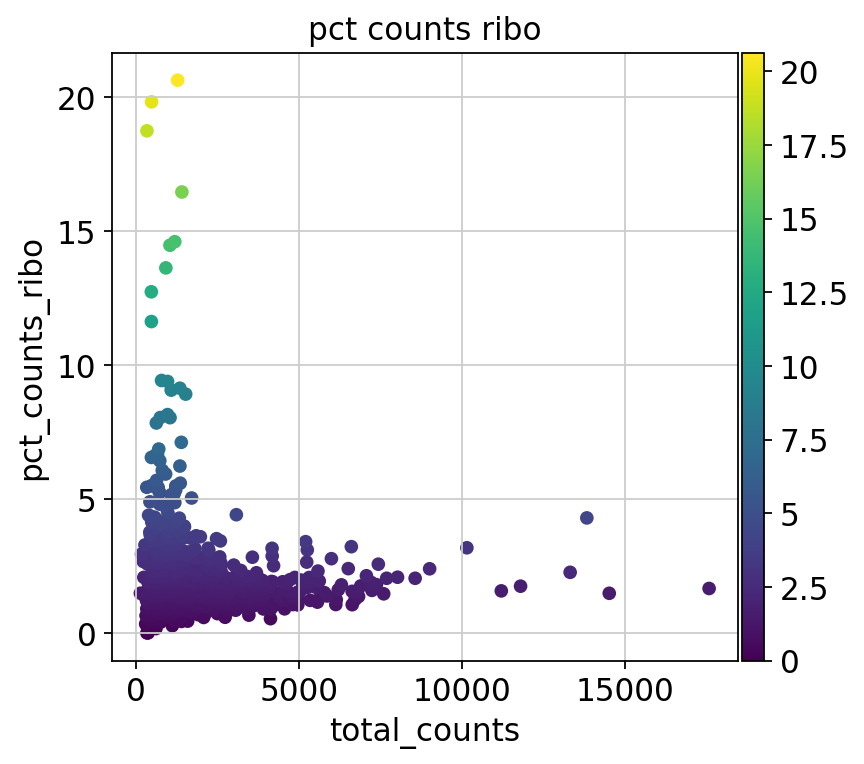

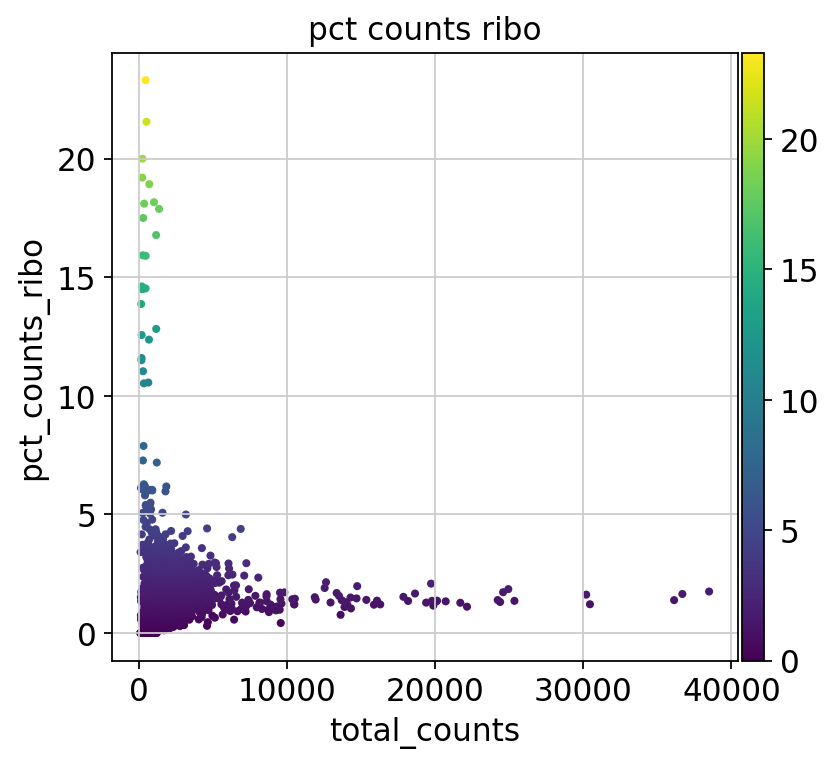

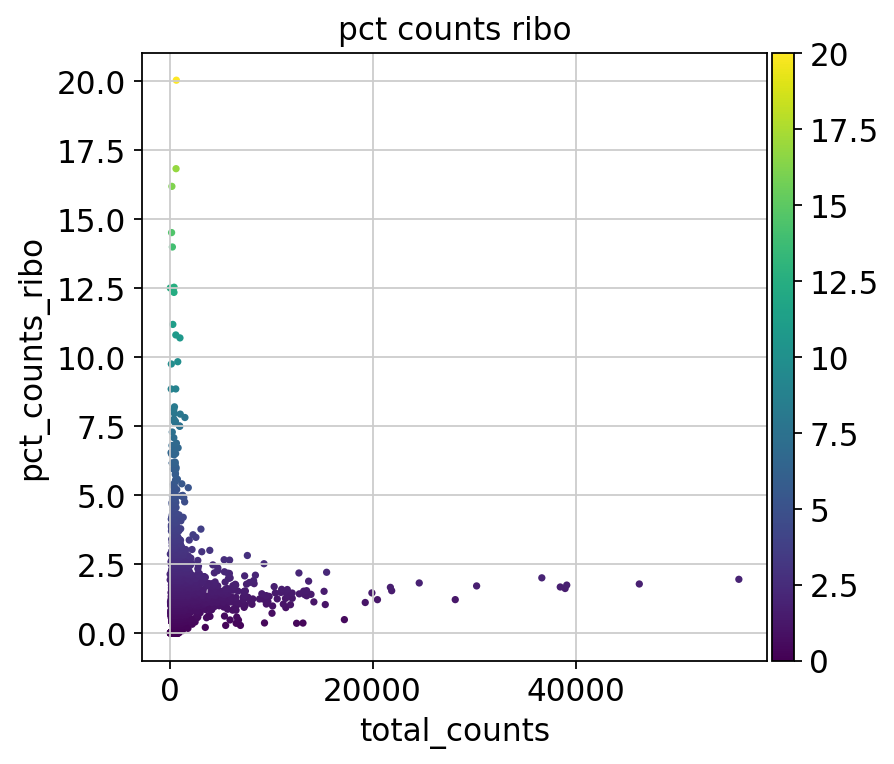

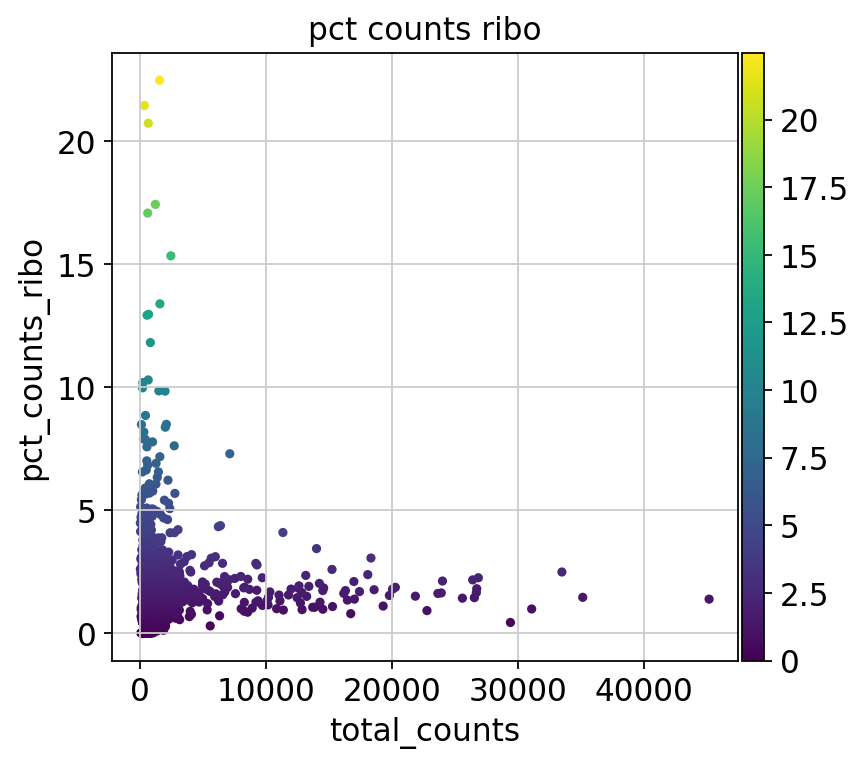

In [85]:
sc.set_figure_params(figsize=[5,5])
for i in range(numberobj):
    sc.pl.scatter(locals()[object_names_preprocessed[i]], x='total_counts', y='pct_counts_ribo',color = 'pct_counts_ribo',show=False)

### Filtering - Mitochondrial% and Ribosomal%
Try 10% first just like many other papers, see later if they form clusters... Smajic seem to have a lot of MT contamination -> dying cells

In [86]:
max_pct_mt = 10.0 
max_pct_ribo = 10.0 
for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['pct_counts_mt'] < max_pct_mt]
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['pct_counts_ribo'] < max_pct_ribo]

## Preprocess - UMIs and gene counts
Here, I want to use some different techniques to plot the data. This is not always necessary, however, you may want to have a close look at your data when you recieve something new. Seaborn package lets us make publication quality and diver plots, while a custom code from the Theis lab, built on Bokeh library, enables interactive plots 

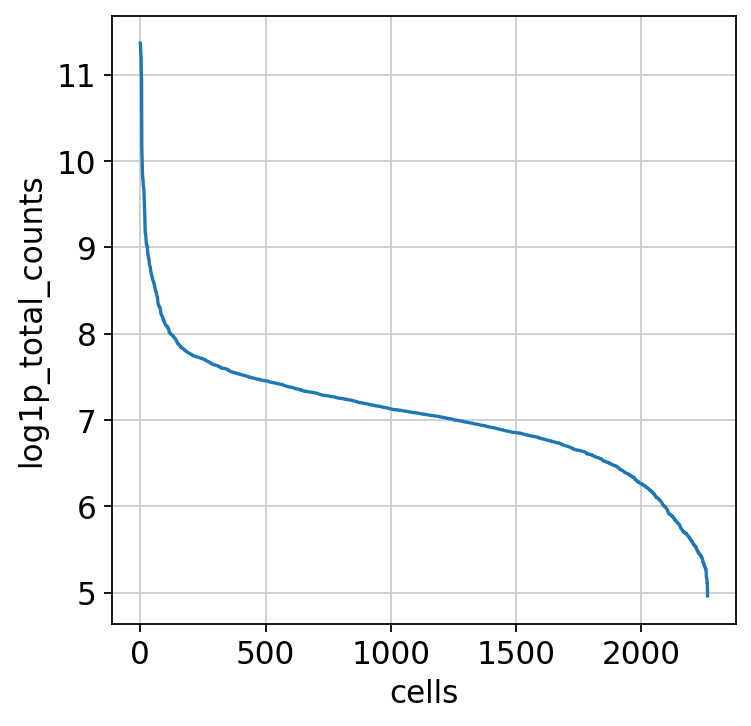

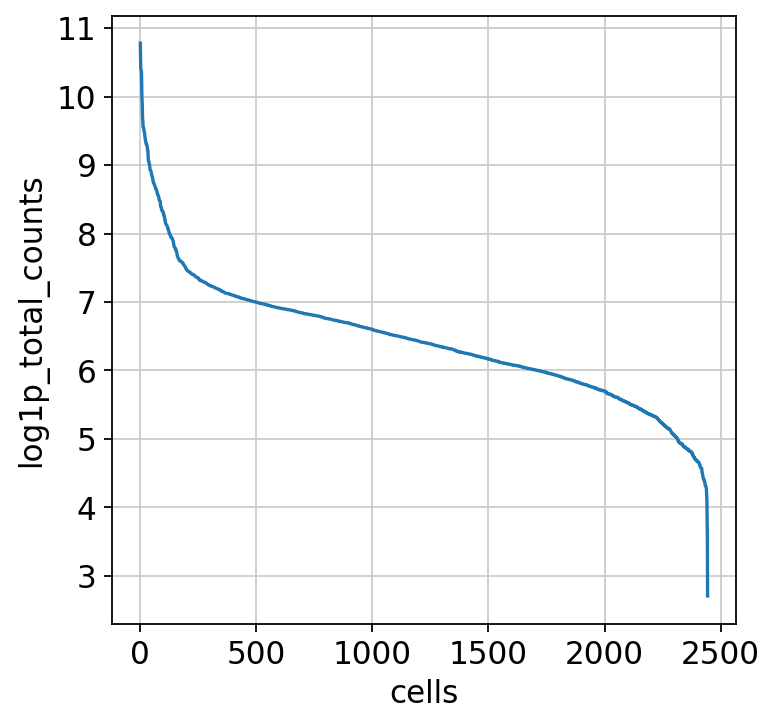

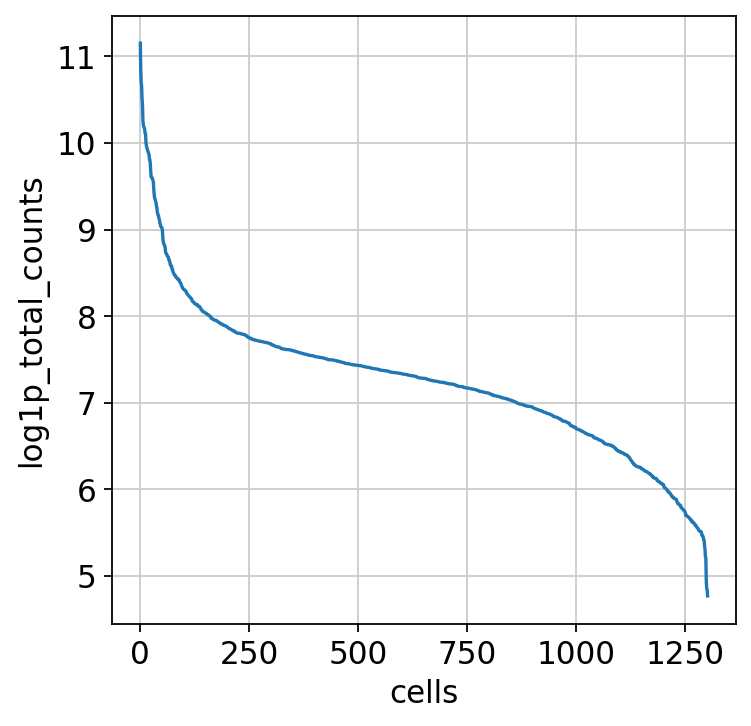

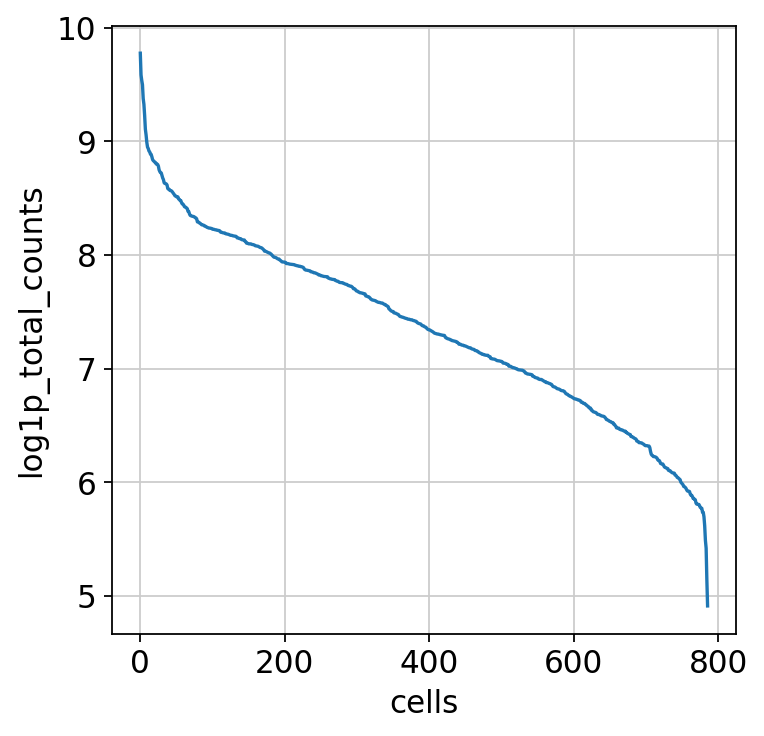

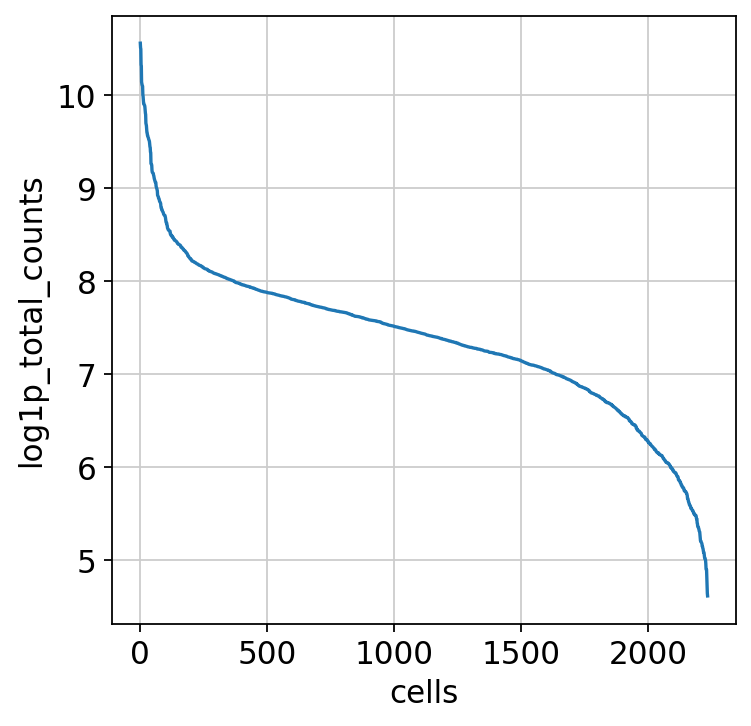

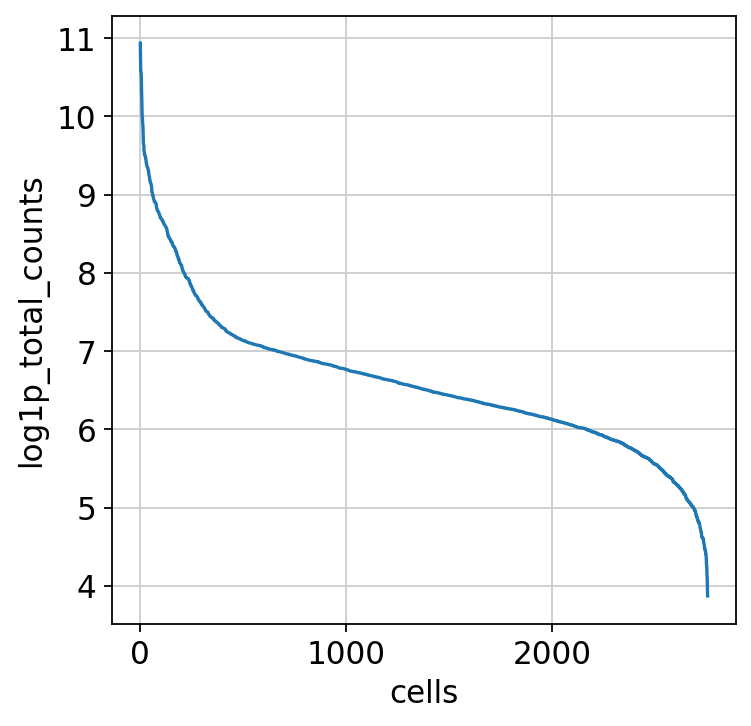

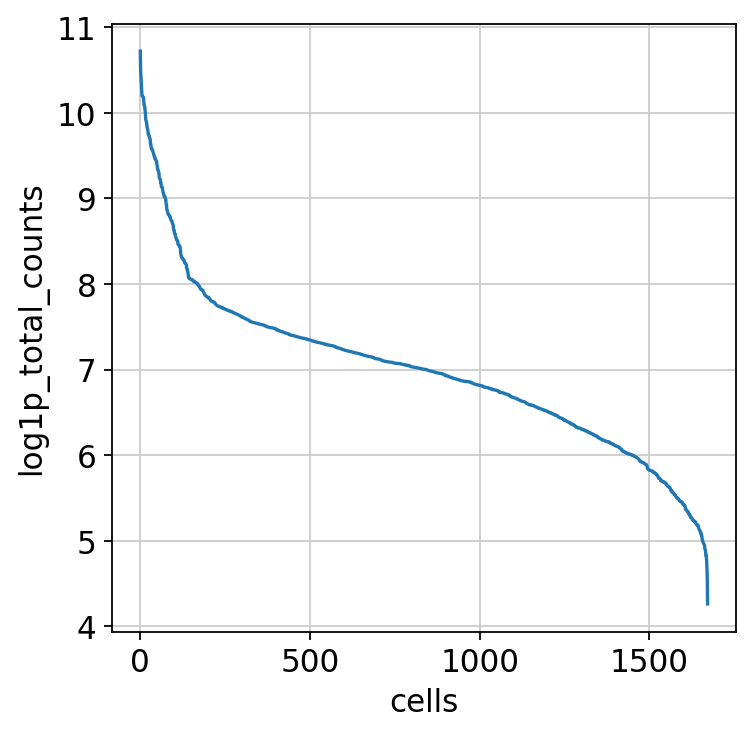

In [87]:
for i in range(numberobj):
    plt.figure()
    total_counts = locals()[object_names_preprocessed[i]].obs['log1p_total_counts'].sort_values(ascending = False)
    index = range(len(total_counts))
    plot = sns.lineplot( x = index, y=total_counts )
    plot.set(xlabel='cells')
    plt.show()

### Seaborn hex plots
These plots allow us to see the distribution of the number of genes and reads, as well as where they are most concentrated (dark colors)

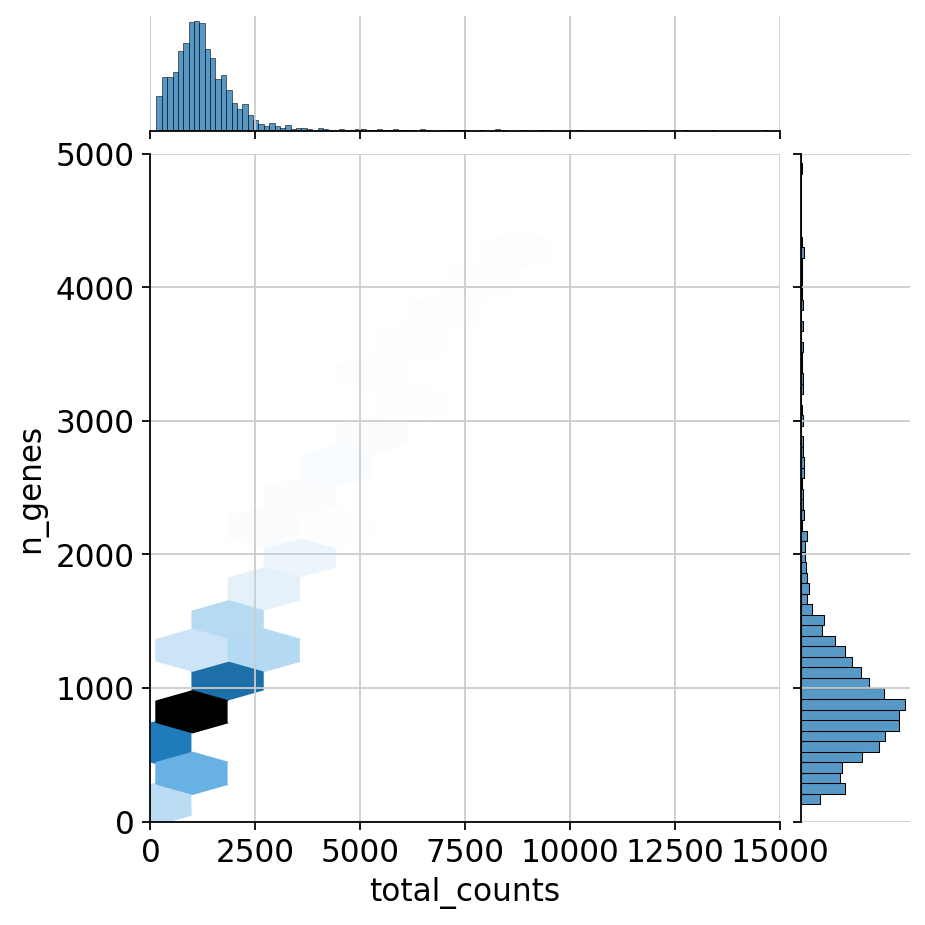

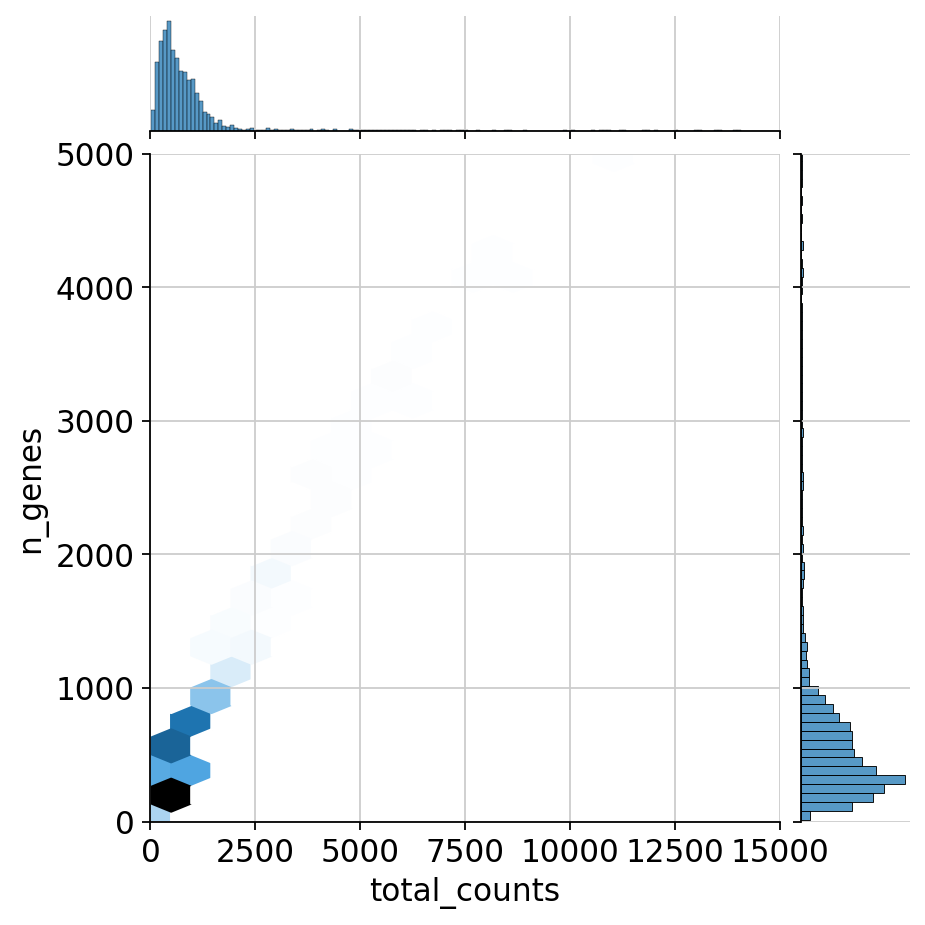

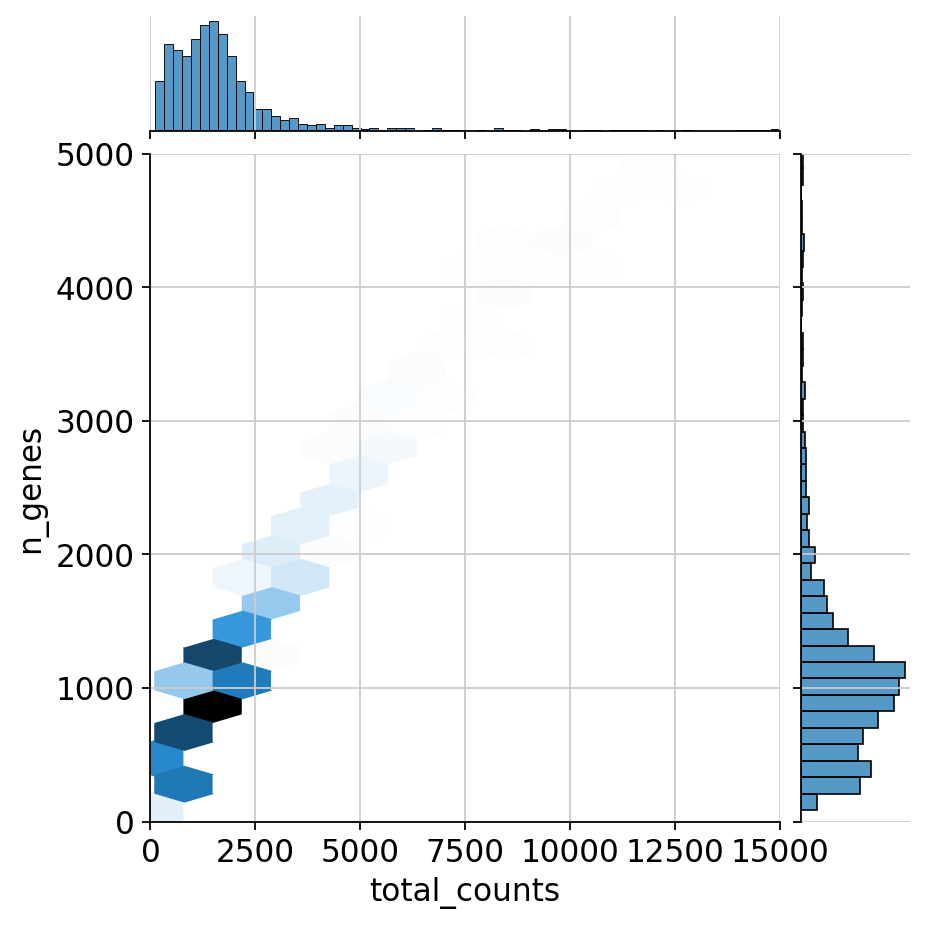

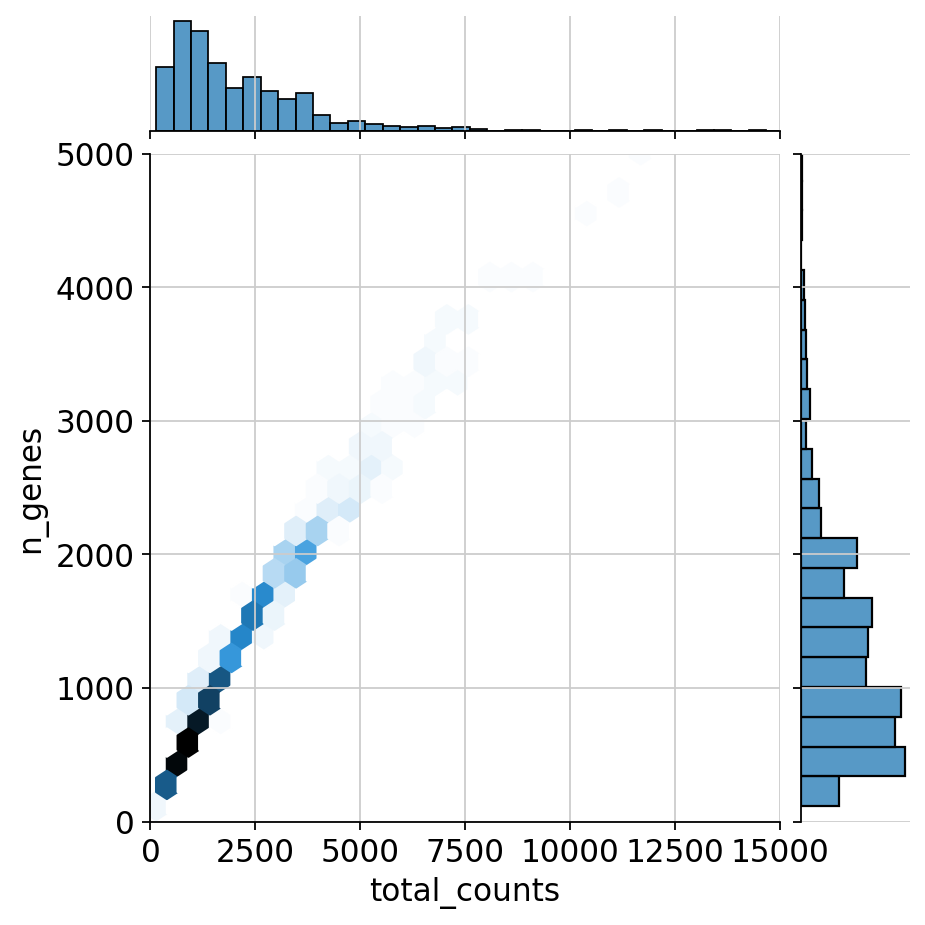

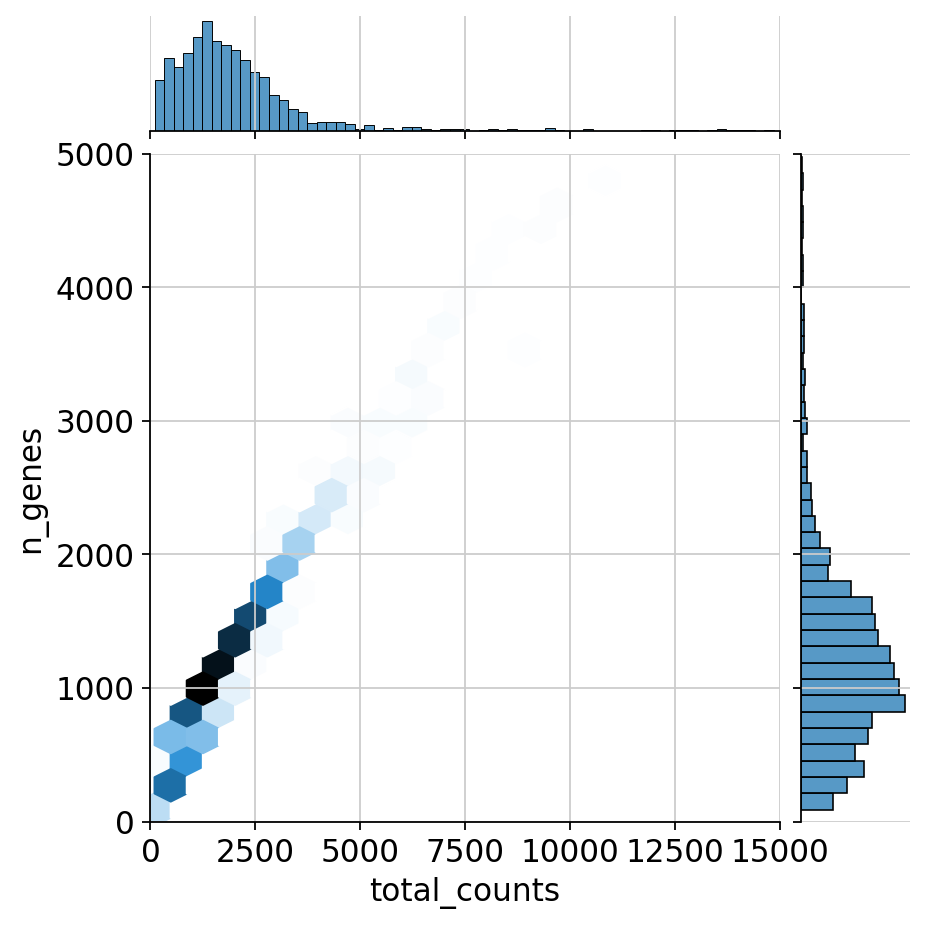

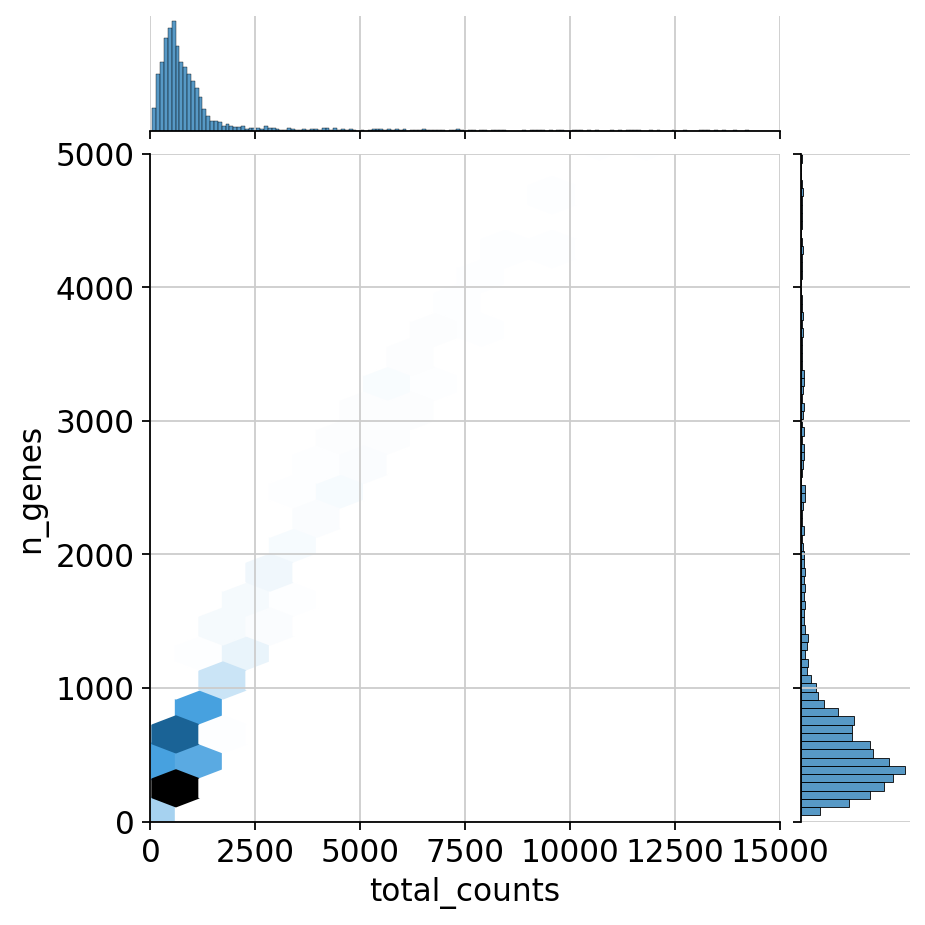

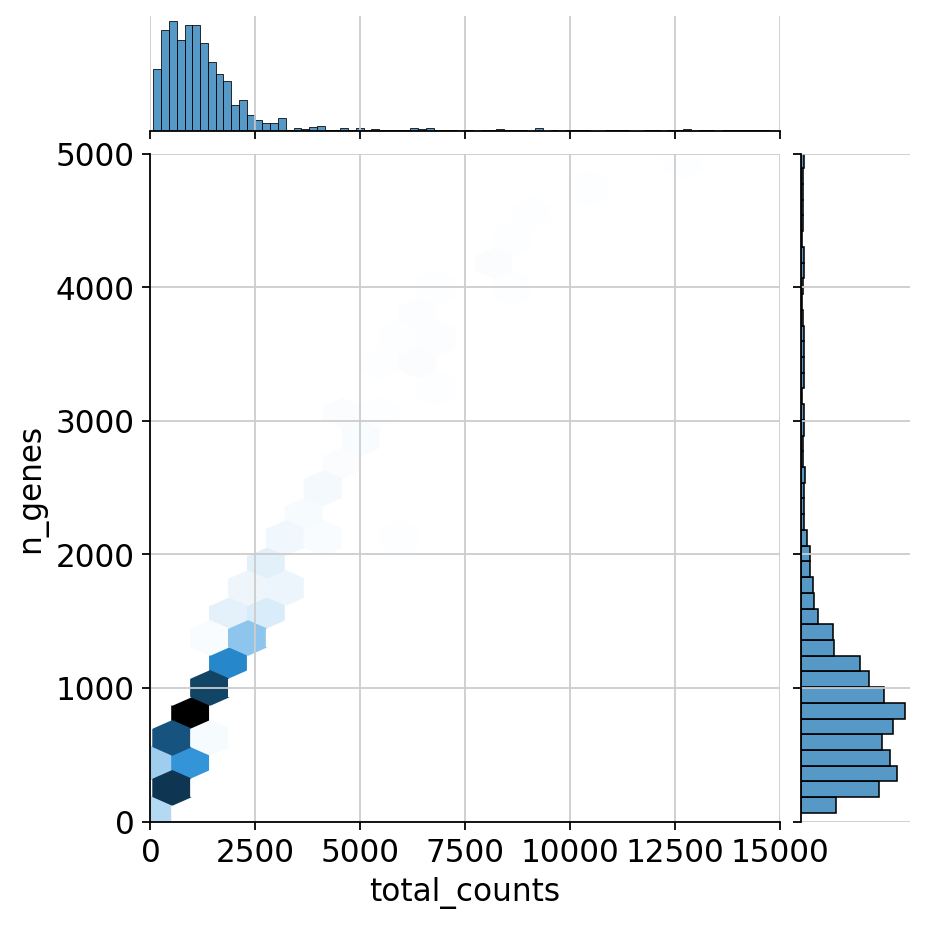

In [88]:
for i in range(numberobj):
    sns.jointplot( x= "total_counts", y= "n_genes", data=locals()[object_names_preprocessed[i]].obs, kind="hex",xlim=[0,15000], ylim=[0,5000])
#kind : { "scatter" | "reg" | "resid" | "kde" | "hex" }

### combined histogram plots
We can compare all libraries to each other using a seaborn histplot

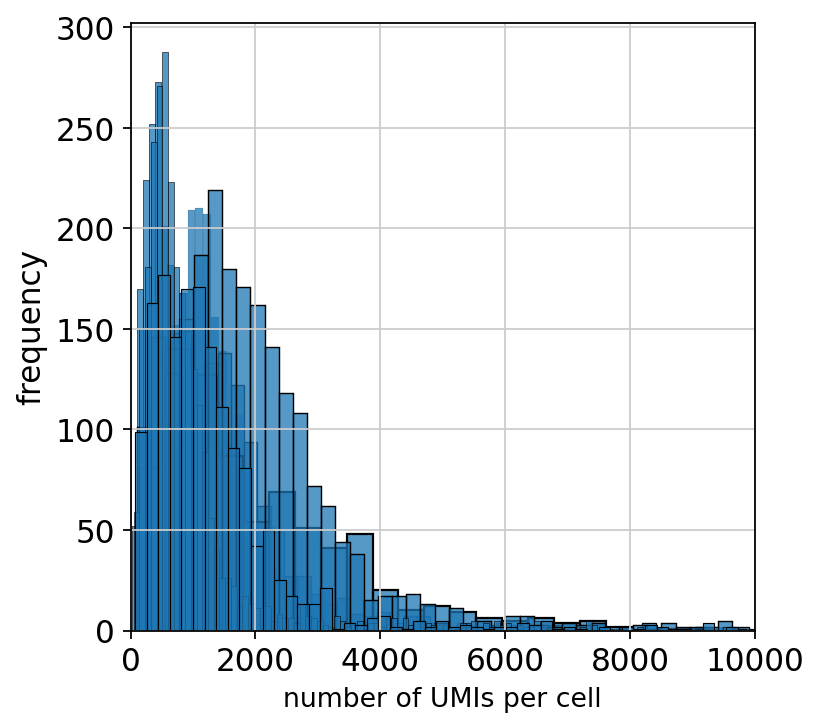

In [91]:

for i in range(numberobj):
    plot = sns.histplot(data=locals()[object_names_preprocessed[i]].obs,x= 'total_counts')
    plot.set_xlabel("number of UMIs per cell", fontsize = 12)
    plot.set_ylabel("frequency", fontsize = 14)
    plot.set_xlim(0,10000)

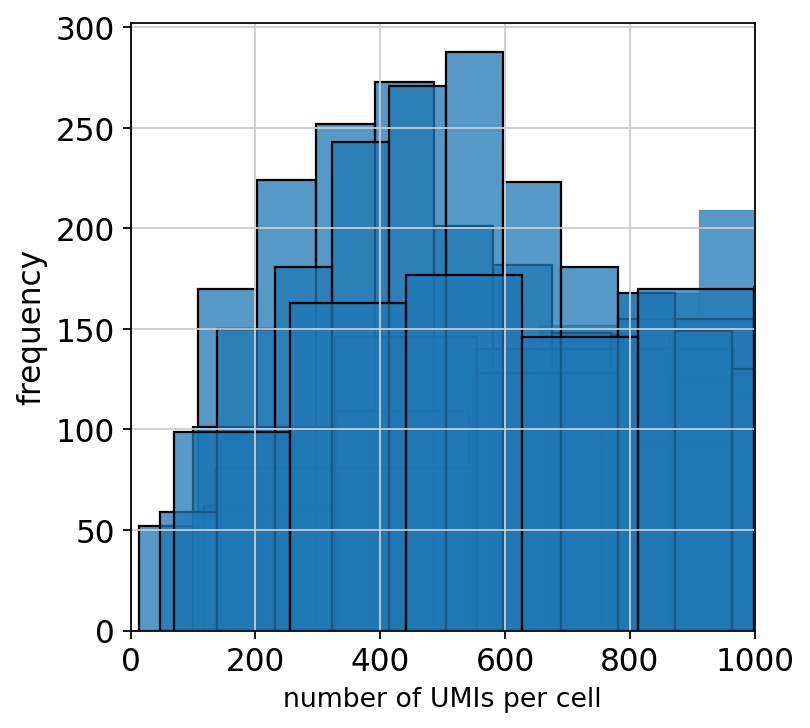

In [93]:

for i in range(numberobj):
    plot2 = sns.histplot(data=locals()[object_names_preprocessed[i]].obs,x= 'total_counts')
    plot2.set_xlabel("number of UMIs per cell", fontsize = 12)
    plot2.set_ylabel("frequency", fontsize = 14)
    plot2.set_xlim(0,1000)

It seems ~12k might be good to start,but almost no atlas has a maximum UMI filter.

### Filtering - UMI and Gene 
Cells with unusual **low/high UMI** counts should be removed. Low counts could be droplets with only ambient RNA while high counts could be doublets. Here we won't filter out cells with high counts as they might represent a celltype. <br>
Similarly cells with unusual **low/high unique gene** counts should be removed. Low gene counts could be droplets with only ambient RNA while high gene counts could be multiplets. <br>
Nonetheless, these thresholds are sample specific and determining them is an iterative process. <br> 

Atlases generally don't have a max gene/UMI threshold as doublets are mostly filtered through methods such as scrublet.

<br>
NOTE: Cell Ranger Count function autmatically filtered out cells with less than 500 UMI counts (might not be the best for heterogenous data). <br>
For more information see: https://www.10xgenomics.com/resources/analysis-guides/common-considerations-for-quality-control-filters-for-single-cell-rna-seq-data 

In [94]:
min_counts = 500 #default
#max_counts = 50000
min_genes = 500
#max_genes = 10000
min_cells = 3



for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['total_counts']>=min_counts]
    #locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['total_counts'] < max_counts[i] ]
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['n_genes'] >= min_genes]
    #locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['n_genes'] < max_genes]
    
    sc.pp.filter_genes(locals()[object_names_preprocessed[i]], min_cells=min_cells)

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/

### Recalculate metrics

In [95]:
for i in range(numberobj):
    sc.pp.calculate_qc_metrics(locals()[object_names_preprocessed[i]], expr_type='counts', var_type='genes', qc_vars=(), percent_top= (), layer= None, use_raw= False, inplace=True, log1p=True)
    print(locals()[object_names_preprocessed[i]])
    print(locals()[object_names_preprocessed[i]].obs['total_counts'])

AnnData object with n_obs × n_vars = 1896 × 21541
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'batch_1', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'scrublet'
CTGTGCTTCAGAAATG-1    86097
GCTCCTACAGATCCAT-1    81607
TCAGCAATCGGTCCGA-1    78457
TGACTAGTCACAGGCC-1    72852
TACGGATTCTGTACGA-1    59543
                      ...  
TGAGCATGTCTAGTGT-1      614
GCAAACTCACGCTTTC-1      594
CACCTTGGTGAGCGAT-1      591
CAGGTGCGTTGATTCG-1      604
ATTGGACGTCAGATAA-1      589
Name: total_counts, Length: 1896, dtype: uint64
AnnD

In [96]:
object_names_filtered =list()

for i in range(numberobj):
    object_names_filtered.append("adata"+"_"+names[i])
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]].copy()

In [98]:
for i in range(numberobj):
    locals()[object_names_preprocessed[i]].write(os.path.join('data/filtered_agarwal_base_'+object_names_filtered[i][6:]+'.h5ad'))

In [99]:
!ls data

filtered_agarwal_base_GSM4157068.h5ad
filtered_agarwal_base_GSM4157069.h5ad
filtered_agarwal_base_GSM4157070.h5ad
filtered_agarwal_base_GSM4157072.h5ad
filtered_agarwal_base_GSM4157074.h5ad
filtered_agarwal_base_GSM4157076.h5ad
filtered_agarwal_base_GSM4157078.h5ad
filtered_altena_base_g004.h5ad
filtered_altena_base_g005.h5ad
filtered_altena_base_g011.h5ad
filtered_altena_base_g012.h5ad
filtered_altena_base_g013.h5ad
filtered_altena_base_g014.h5ad
filtered_altena_base_g015.h5ad
filtered_altena_base_g016.h5ad
filtered_altena_base_g017.h5ad
filtered_altena_base_g018.h5ad
filtered_altena_base_g019.h5ad
filtered_altena_base_g020.h5ad
filtered_smajic_base_SRR12621867.h5ad
filtered_smajic_base_SRR12621868.h5ad
filtered_smajic_base_SRR12621869.h5ad
filtered_smajic_base_SRR12621870.h5ad
filtered_smajic_base_SRR12621871.h5ad
filtered_smajic_base_SRR12621872.h5ad
filtered_smajic_doublets_SRR12621867.h5ad
filtered_smajic_doublets_SRR12621868.h5ad
filtered_smajic_doublets_SRR12621869.h5ad
filtered